In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_blobs
from scipy.linalg import null_space
#from sklearn.mixture import GaussianMixture
from scipy.stats import multivariate_normal
import torch
from PIL import Image
import time
import os
import sys
import random
import argparse
import torch
import torch.nn as nn
import torch.optim as optim
from scipy.ndimage import gaussian_filter
import random
from sklearn.decomposition import PCA
import scipy.stats

import seaborn as sns
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

%matplotlib inline

working_dir = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/code'
sys.path.insert(0, working_dir)
from inverse_tasks_func import synthesis
from model_loader_func import load_UNet
from network_5 import PointUNet

In [4]:
class GaussianMixture:
  def __init__(self, mus, covs, weights):
    """
    mus: a list of K 1d np arrays (D,)
    covs: a list of K 2d np arrays (D, D)
    weights: a list or array of K unnormalized non-negative weights, signifying the possibility of sampling from each branch.
      They will be normalized to sum to 1. If they sum to zero, it will err.
    """
    self.n_component = len(mus)
    self.mus = mus
    self.covs = covs
    self.precs = [np.linalg.inv(cov) for cov in covs]
    self.weights = np.array(weights)
    self.norm_weights = self.weights / self.weights.sum()
    self.RVs = []
    for i in range(len(mus)):
      self.RVs.append(multivariate_normal(mus[i], covs[i]))
    self.dim = len(mus[0])

  def add_component(self, mu, cov, weight=1):
    self.mus.append(mu)
    self.covs.append(cov)
    self.precs.append(np.linalg.inv(cov))
    self.RVs.append(multivariate_normal(mu, cov))
    self.weights.append(weight)
    self.norm_weights = self.weights / self.weights.sum()
    self.n_component += 1

  def pdf_decompose(self, x):
    """
      probability density (PDF) at $x$.
    """
    component_pdf = []
    prob = None
    for weight, RV in zip(self.norm_weights, self.RVs):
        pdf = weight * RV.pdf(x)
        prob = pdf if prob is None else (prob + pdf)
        component_pdf.append(pdf)
    component_pdf = np.array(component_pdf)
    return prob, component_pdf

  def pdf(self, x):
    """
      probability density (PDF) at $x$.
    """
    prob = None
    for weight, RV in zip(self.norm_weights, self.RVs):
        pdf = weight * RV.pdf(x)
        prob = pdf if prob is None else (prob + pdf)
    # component_pdf = np.array([rv.pdf(x) for rv in self.RVs]).T
    # prob = np.dot(component_pdf, self.norm_weights)
    return prob

  def score(self, x):
    component_pdf = np.array([rv.pdf(x) for rv in self.RVs]).T
    weighted_compon_pdf = component_pdf * self.norm_weights[np.newaxis, :]
    participance = weighted_compon_pdf / weighted_compon_pdf.sum(axis=1, keepdims=True)

    scores = np.zeros_like(x)
    for i in range(self.n_component):
        # Ensure mean is broadcast correctly
        mean_expanded = np.broadcast_to(self.mus[i], x.shape)
        gradvec = - (x - mean_expanded) @ self.precs[i]
        scores += participance[:, i:i+1] * gradvec

    return scores

  def score_decompose(self, x):
    """
    Compute the grad to each branch for the score $\nabla_x \log p(x)$ for the given $x$.
    """
    component_pdf = np.array([rv.pdf(x) for rv in self.RVs]).T
    weighted_compon_pdf = component_pdf * self.norm_weights[np.newaxis, :]
    participance = weighted_compon_pdf / weighted_compon_pdf.sum(axis=1, keepdims=True)

    gradvec_list = []
    for i in range(self.n_component):
      gradvec = - (x - self.mus[i]) @ self.precs[i]
      gradvec_list.append(gradvec)
      # scores += participance[:, i:i+1] * gradvec

    return gradvec_list, participance

  def sample(self, N):
    """ Draw N samples from Gaussian mixture
    Procedure:
      Draw N samples from each Gaussian
      Draw N indices, according to the weights.
      Choose sample between the branches according to the indices.
    """
    rand_component = np.random.choice(self.n_component, size=N, p=self.norm_weights)
    all_samples = np.array([rv.rvs(N) for rv in self.RVs])
    gmm_samps = all_samples[rand_component, np.arange(N),:]
    return gmm_samps, rand_component, all_samples

In [5]:
working_dir = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/datasets'
os.chdir(working_dir)
gmm_params = torch.load('gmm_params_reference.pt')

<ipython-input-5-51afb0b8833e>:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  gmm_params = torch.load('gmm_params_reference.pt')


In [6]:
def categorize_samples_by_distance(clean_samples, mus):

    mus_tensor = torch.tensor(mus, device=clean_samples.device, dtype=clean_samples.dtype)

    distances = torch.stack([torch.norm(clean_samples.unsqueeze(1) - mu, dim=2)
                           for mu in mus_tensor]).min(dim=0).values

    thresholds = torch.quantile(distances,
                              torch.tensor([0.10, 0.50],
                                         device=distances.device,
                                         dtype=distances.dtype))

    close_mask = (distances <= thresholds[0]).squeeze()
    medium_mask = ((distances > thresholds[0]) & (distances <= thresholds[1])).squeeze()
    far_mask = (distances > thresholds[1]).squeeze()

    return close_mask, medium_mask, far_mask

In [7]:
from typing_extensions import final
def plot_trajectory_comparison(model, gmm, device, plot_size=50, n_steps=1000, step_size=0.01, noise_type='gaussian'):
    model.eval()

    x = np.linspace(-4, 4, plot_size)
    y = np.linspace(-4, 4, plot_size)
    X, Y = np.meshgrid(x, y)
    points = np.stack([X.flatten(), Y.flatten()], axis=1)
    points_tensor = torch.tensor(points, device=device, dtype=torch.float32)

    close_mask, medium_mask, far_mask = categorize_samples_by_distance(points_tensor, gmm.mus)

    # Function to generate GMM score-based trajectories
    def gmm_score_trajectory(start_points, n_steps=n_steps, step_size=step_size):
        trajectories = [start_points]
        current_points = start_points.copy()

        for _ in range(n_steps):
            score = gmm.score(current_points)
            current_points = current_points + step_size * score
            trajectories.append(current_points.copy())

        return np.stack(trajectories)

    gmm_trajectories = gmm_score_trajectory(points)

    with torch.no_grad():
        _, all_points, _ = univ_inv_solve_gmm(
            model, points_tensor, device,
            sig_0=1.0, sig_L=0.01,
            h0=0.01, beta=0.01,
            freq=100, max_T=2000, noise_type=noise_type
        )
        diffusion_trajectories = torch.stack(all_points).cpu().numpy()

    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 6))

    step = 4  # skip points for clarity
    keep_mask = np.zeros_like(X, dtype=bool)
    keep_mask[::step, ::step] = True
    keep_mask = keep_mask.flatten()

    centers = np.array(gmm.mus)

    ax1.set_title('GMM Score-based Trajectories')
    for idx in range(len(points)):
        if keep_mask[idx]:
            if close_mask[idx]:
                color = 'tab:red'
            elif medium_mask[idx]:
                color = 'tab:green'
            else:
                color = 'tab:purple'
            trajectory = gmm_trajectories[:, idx, :]
            ax1.plot(trajectory[:, 0], trajectory[:, 1], '-',
                    color=color, alpha=0.3, linewidth=1)

    ax1.scatter(centers[:, 0], centers[:, 1],
               alpha=1.0, color='orange', marker='*', s=100)

    #diffusion trajectories
    ax2.set_title('Diffusion Model Trajectories')
    for idx in range(len(points)):
        if keep_mask[idx]:
            if close_mask[idx]:
                color = 'tab:red'
            elif medium_mask[idx]:
                color = 'tab:green'
            else:
                color = 'tab:purple'
            trajectory = diffusion_trajectories[:, idx, :]
            ax2.plot(trajectory[:, 0], trajectory[:, 1], '-',
                    color=color, alpha=0.3, linewidth=1)

    ax2.scatter(centers[:, 0], centers[:, 1],
               alpha=1.0, color='orange', marker='*', s=100)

    from matplotlib.lines import Line2D
    legend_elements = [
        Line2D([0], [0], color='tab:red', label='Close'),
        Line2D([0], [0], color='tab:green', label='Mid'),
        Line2D([0], [0], color='tab:purple', label='Far'),
        Line2D([0], [0], color='orange', marker='*', label='Centers',
               markersize=10, linestyle='None')
    ]
    ax1.legend(handles=legend_elements)
    ax2.legend(handles=legend_elements)


    l2_center_close = []
    l2_center_medium = []
    l2_center_far = []

    for points in gmm_trajectories:
        center_dists = torch.stack([
            torch.norm(torch.tensor(points, device=device) - torch.tensor(mu, device=device), dim=1)
            for mu in gmm.mus
        ])
        min_dists = center_dists.min(dim=0).values

        l2_center_close.append(min_dists[close_mask].mean().item())
        l2_center_medium.append(min_dists[medium_mask].mean().item())
        l2_center_far.append(min_dists[far_mask].mean().item())

    steps = np.arange(len(l2_center_close))
    ax3.plot(steps, l2_center_close, '-', label='Close', color='tab:red')
    ax3.plot(steps, l2_center_medium, '-', label='Mid', color='tab:green')
    ax3.plot(steps, l2_center_far, '-', label='Far', color='tab:purple')
    ax3.set_title('L2 Distances to Centers During GMM True Score Denoising')
    ax3.set_xlabel('Denoising Step')
    ax3.set_ylabel('L2 Distance')
    ax3.legend()
    ax3.grid(True)

    for ax in [ax1, ax2]:
        ax.set_xlim(-4, 4)
        ax.set_ylim(-4, 4)
        ax.set_aspect('equal')

    plt.tight_layout()
    return fig

In [8]:
def plot_score_fields(model, gmm, device, noise_levels=[0.01, 0.1, 0.5, 1.0], plot_size=50, noise_type='gaussian'):
    model.eval()

    x = np.linspace(-4, 4, plot_size)
    y = np.linspace(-4, 4, plot_size)
    X, Y = np.meshgrid(x, y)
    points = np.stack([X.flatten(), Y.flatten()], axis=1)
    points_tensor = torch.tensor(points, device=device, dtype=torch.float32)

    true_scores = torch.tensor(gmm.score(points_tensor.cpu().numpy()), device=device)
    close_mask, medium_mask, far_mask = categorize_samples_by_distance(points_tensor, gmm.mus)

    n_levels = len(noise_levels)
    fig, axes = plt.subplots(2, 3, figsize=(15, 8))

    with torch.no_grad():
        denoised_points = model(points_tensor)
        derived_scores = -(points_tensor - denoised_points)

        ax = axes[0,0]
        points_grid = np.stack([X.flatten(), Y.flatten()], axis=1)
        Z = gmm.pdf(points_grid).reshape(plot_size, plot_size)
        for i in range(plot_size):
            for j in range(plot_size):
                point = np.array([[X[i,j], Y[i,j]]])
                Z[i,j] = gmm.pdf(point)

        contour = ax.contourf(X, Y, Z, levels=20, cmap='viridis')
        plt.colorbar(contour, ax=ax)
        ax.set_title('GMM Density')


        ax = axes[0,1]
        quiver_true = ax.quiver(points[:, 0], points[:, 1],
                                  true_scores.cpu()[:, 0], true_scores.cpu()[:, 1],
                                  alpha=0.5)
        ax.set_title(f'GMM True Score Field')


        ax = axes[0,2]
        quiver_derived = ax.quiver(points[:, 0], points[:, 1],
                                     derived_scores.cpu()[:, 0], derived_scores.cpu()[:, 1],
                                     alpha=0.5)
        ax.set_title(f'Diffusion Score Field')


        cos_sim = torch.nn.functional.cosine_similarity(derived_scores, true_scores).mean()
        l2_diffs = torch.norm(derived_scores - true_scores, dim=1)
        avg_l2 = l2_diffs.mean()

        ax.text(0.05, 0.95, f'L2: {avg_l2:.2f}',
                   transform=ax.transAxes, bbox=dict(facecolor='white', alpha=0.8))

        ax = axes[1,0]
        colors = np.empty(len(points), dtype=object)
        colors[close_mask.cpu()] = 'tab:red'
        colors[medium_mask.cpu()] = 'tab:green'
        colors[far_mask.cpu()] = 'tab:purple'

        quiver = ax.quiver(points[:, 0], points[:, 1],
                          derived_scores.cpu()[:, 0], derived_scores.cpu()[:, 1],
                          color=colors, alpha=0.5)

        l2_diffs = torch.norm(derived_scores - true_scores, dim=1)

        l2_close = l2_diffs[close_mask].mean()
        l2_medium = l2_diffs[medium_mask].mean()
        l2_far = l2_diffs[far_mask].mean()

        from matplotlib.lines import Line2D
        legend_elements = [Line2D([0], [0], color='tab:red', label=f'Close - L2 {l2_close:.2f}'),
                          Line2D([0], [0], color='tab:green', label=f'Mid - L2 {l2_medium:.2f}'),
                          Line2D([0], [0], color='tab:purple', label=f'Far - L2 {l2_far:.2f}')]
        ax.legend(handles=legend_elements)
        ax.set_title('Diffusion Score Field by Distance Group')

        #L2 scatter by distance
        ax = axes[1,1]
        with torch.no_grad():
            denoised_points = model(points_tensor)
            derived_scores = -(points_tensor - denoised_points)

        distances = torch.stack([
            torch.norm(points_tensor - torch.tensor(mu, device=device), dim=1)
            for mu in gmm.mus
        ]).min(dim=0).values.cpu()

        true_norms = torch.norm(true_scores, dim=1).cpu()
        derived_norms = torch.norm(derived_scores, dim=1).cpu()
        l2_diffs = torch.norm(derived_scores - true_scores, dim=1)

        colors = np.empty(len(points), dtype=object)
        colors[close_mask.cpu()] = 'tab:red'
        colors[medium_mask.cpu()] = 'tab:green'
        colors[far_mask.cpu()] = 'tab:purple'

        for mask, color, label in zip([close_mask, medium_mask, far_mask],
                                    ['tab:red', 'tab:green', 'tab:purple'],
                                    ['Close', 'Mid', 'Far']):
            mask_cpu = mask.cpu()
            ax.scatter(distances[mask_cpu], l2_diffs[mask_cpu],
                      c=color, alpha=0.5, label=f'{label}')

        ax.set_title('Score Field L2 vs Distance to Center')
        ax.set_xlabel('Distance to Nearest Center')
        ax.set_ylabel('L2 Distance')
        ax.legend()

        ax = axes[1,2]
        _, all_points, _ = univ_inv_solve_gmm(
            model, points_tensor, device,
            sig_0=1.0,
            sig_L=0.01,
            h0=0.01,
            beta=0.01,
            freq=100,
            max_T=2000,
            noise_type=noise_type
        )

        l2_center_close = []
        l2_center_medium = []
        l2_center_far = []

        for points in all_points:
            center_dists = torch.stack([
                torch.norm(points - torch.tensor(mu, device=device), dim=1)
                for mu in gmm.mus
            ])
            min_dists = center_dists.min(dim=0).values

            l2_center_close.append(min_dists[close_mask].mean().item())
            l2_center_medium.append(min_dists[medium_mask].mean().item())
            l2_center_far.append(min_dists[far_mask].mean().item())

        steps = np.arange(len(l2_center_close))
        ax.plot(steps, l2_center_close, '-', label='Close', color='tab:red')
        ax.plot(steps, l2_center_medium, '-', label='Mid', color='tab:green')
        ax.plot(steps, l2_center_far, '-', label='Far', color='tab:purple')
        ax.set_title('L2 Distances to Centers During Denoising')
        ax.set_xlabel('Denoising Step')
        ax.set_ylabel('L2 Distance')
        ax.legend()
        ax.grid(True)

        ax = axes[1,2]

    plt.tight_layout()

    trajectory_fig = plot_trajectory_comparison(model, gmm, device, noise_type=noise_type)

    return fig, trajectory_fig

In [9]:
def add_noise(x, noise_scale, device, noise_type='gaussian', model=None):
    """
    noise_scale: single value for noise magnitude
    noise_type: Type of noise to add ('gaussian', 'uniform', 'poisson', 'saltpepper', 'exponential')
    """
    if noise_type == 'gaussian':
        noise = torch.randn_like(x) * noise_scale

    elif noise_type == 'uniform':
        noise = (2 * torch.rand_like(x) - 1) * noise_scale

    elif noise_type == 'poisson':
        scaled_x = x - x.min() + 1e-3
        rate = scaled_x / noise_scale
        noise = (torch.poisson(rate) - rate) * noise_scale

    elif noise_type == 'laplace':
        laplace_dist = torch.distributions.Laplace(loc=0.0, scale=1.0)
        base_noise = laplace_dist.sample(x.shape).to(device)
        noise = base_noise * noise_scale

    elif noise_type == 'langevin':
        if model is None:
            raise ValueError("Model required for Langevin sampling")

        with torch.no_grad():
            score = (x - model(x)) / (noise_scale)**2  #score estimated from denoiser

            drift = 0.5 * noise_scale * score
            diffusion = torch.sqrt(noise_scale) * torch.randn_like(x)
            noise = drift + diffusion

    elif noise_type == 'saltpepper':
        noise = torch.zeros_like(x)
        mask = torch.rand_like(x) < noise_scale
        noise[mask] = torch.randint(0, 2, mask.sum().shape).to(device) * 2 - 1

    elif noise_type == 'exponential':
        noise = (torch.exp(torch.randn_like(x)) - torch.e) * noise_scale

    else:
        raise ValueError(f"Unknown noise type: {noise_type}")

    return noise

def univ_inv_solve_gmm(model, noisy_points, device, sig_0=1, sig_L=0.01, h0=0.01, beta=0.01,
                      freq=10, max_T=2000, noise_type='gaussian'):
    y = noisy_points.clone()
    sigmas = []
    intermed_ys = [y.clone()]
    t = 1
    start_time = time.time()

    # Langevin parameters
    drift_weight = 1.0  # Increase influence of score-based drift
    diffusion_decay = 0.995  # Gradually reduce noise
    min_temp = 0.1  # Minimum temperature for noise

    while True:
        with torch.no_grad():
            model_out = model(y)
        d = y - model_out #score computed from denoiser residual
        sigma = torch.norm(d.view(-1)) / np.sqrt(d.numel()) #current noise level for stopping criteria
        sigmas.append(sigma.item()) #sigma list

        if t % freq == 0 or t == 1:
            print(f"Iteration {t}: sigma={sigma:.4f}")

        if sigma <= sig_L or t >= max_T: #if sigma below stopping criteria or reached max steps
            break

        h = h0 #step size
        gamma = 0.1 * sigma * np.sqrt(max((1 - beta * h)**2 - (1 - h)**2, 1e-8))  # Changed back to 0.1
        if noise_type == 'langevin':
            # Score estimate from model
            score = d / (sigma**2)  # Use current sigma for scaling

            current_temp = max(min_temp, diffusion_decay**t)
            drift = drift_weight * gamma * score
            diffusion = current_temp * torch.sqrt(gamma) * torch.randn_like(y)
            noise = drift + diffusion
        else:
            # Original noise addition for other noise types
            noise = add_noise(y, gamma, device, noise_type)

        y = y - h * d + noise
        intermed_ys.append(y.clone())
        t += 1

    print(f"Final sigma: {sigma:.4f}, total iterations: {t}")
    print(f"Avg time per iteration: {(time.time() - start_time) / t:.4f} s")
    return y, intermed_ys, sigmas

In [10]:
def analyze_model(model_path, gmm_params, device='cpu', noise_type='gaussian'):

    mus, covs, weights = gmm_params
    gmm = GaussianMixture(mus, covs, weights)

    class Args:
        def __init__(self):
            self.num_blocks = 3
            self.num_kernels = 64
            self.num_enc_conv = 2
            self.num_mid_conv = 2
            self.num_dec_conv = 2
            self.bias = True
            self.input_dim = 2

    args = Args()
    model = PointUNet(args).to(device)
    model.load_state_dict(torch.load(model_path, map_location=device))

    score_fig, trajectory_fig = plot_score_fields(model, gmm, device, noise_type=noise_type)

    return score_fig, trajectory_fig

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d']['mus']
covs = gmm_params['2d']['covs']
weights = gmm_params['2d']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/gaussian/noise_scale_0001_001PointUNet_denoising/gmm_new_2d/100000/denoiser_epoch_10.pt'
model_noise_type = 'gaussian'

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.4615
Iteration 100: sigma=0.2142
Iteration 200: sigma=0.1299
Iteration 300: sigma=0.0945
Iteration 400: sigma=0.0733
Iteration 500: sigma=0.0598
Iteration 600: sigma=0.0511
Iteration 700: sigma=0.0455
Iteration 800: sigma=0.0422
Iteration 900: sigma=0.0405
Iteration 1000: sigma=0.0392
Iteration 1100: sigma=0.0382
Iteration 1200: sigma=0.0377
Iteration 1300: sigma=0.0375
Iteration 1400: sigma=0.0371
Iteration 1500: sigma=0.0365
Iteration 1600: sigma=0.0357
Iteration 1700: sigma=0.0352
Iteration 1800: sigma=0.0350
Iteration 1900: sigma=0.0349
Iteration 2000: sigma=0.0350
Final sigma: 0.0350, total iterations: 2000
Avg time per iteration: 0.1078 s
Iteration 1: sigma=0.4615
Iteration 100: sigma=0.2138
Iteration 200: sigma=0.1296
Iteration 300: sigma=0.0943
Iteration 400: sigma=0.0729
Iteration 500: sigma=0.0595
Iteration 600: sigma=0.0509
Iteration 700: sigma=0.0455
Iteration 800: sigma=0.0422
Iteration 900: sigma=0.0403
Iteration 1000: sigma=0.0390
Iteration 1100: sig

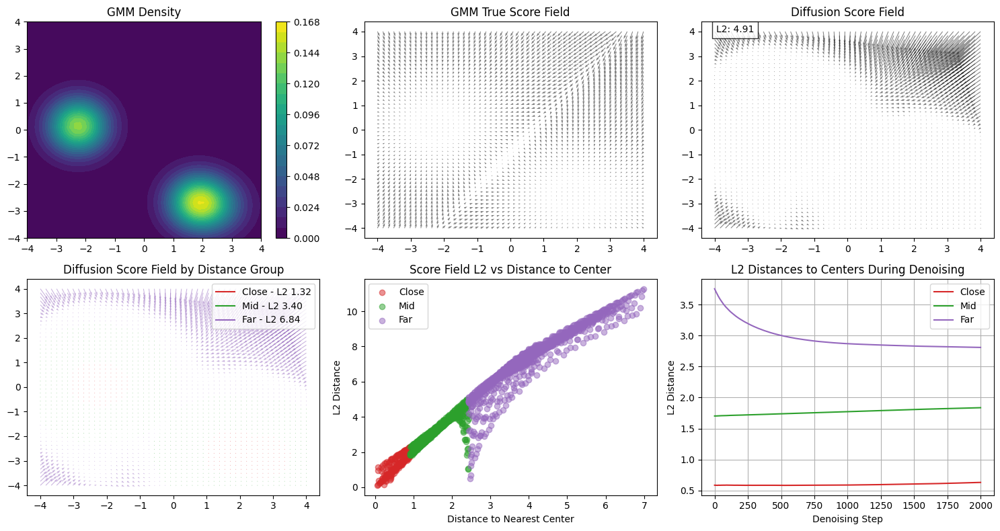

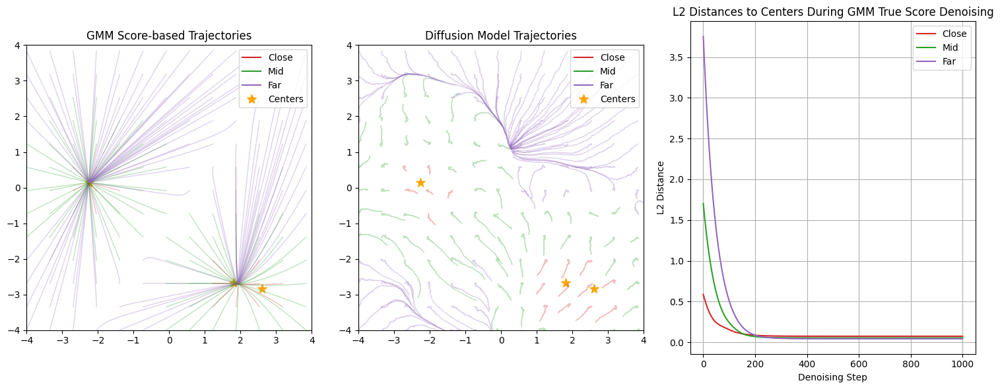

In [ ]:
score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

#score_fig.savefig('2d_score_fields.png', dpi=300, bbox_inches='tight')
#denoising_fig.savefig('denoising_analysis.png', dpi=300, bbox_inches='tight')

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.3840
Iteration 100: sigma=0.1890
Iteration 200: sigma=0.1271
Iteration 300: sigma=0.0961
Iteration 400: sigma=0.0753
Iteration 500: sigma=0.0627
Iteration 600: sigma=0.0556
Iteration 700: sigma=0.0511
Iteration 800: sigma=0.0478
Iteration 900: sigma=0.0449
Iteration 1000: sigma=0.0422
Iteration 1100: sigma=0.0398
Iteration 1200: sigma=0.0377
Iteration 1300: sigma=0.0358
Iteration 1400: sigma=0.0340
Iteration 1500: sigma=0.0325
Iteration 1600: sigma=0.0313
Iteration 1700: sigma=0.0302
Iteration 1800: sigma=0.0294
Iteration 1900: sigma=0.0286
Iteration 2000: sigma=0.0279
Final sigma: 0.0279, total iterations: 2000
Avg time per iteration: 0.1071 s
Iteration 1: sigma=0.3840
Iteration 100: sigma=0.1890
Iteration 200: sigma=0.1270
Iteration 300: sigma=0.0960
Iteration 400: sigma=0.0754
Iteration 500: sigma=0.0631
Iteration 600: sigma=0.0560
Iteration 700: sigma=0.0510
Iteration 800: sigma=0.0470
Iteration 900: sigma=0.0441
Iteration 1000: sigma=0.0419
Iteration 1100: sig

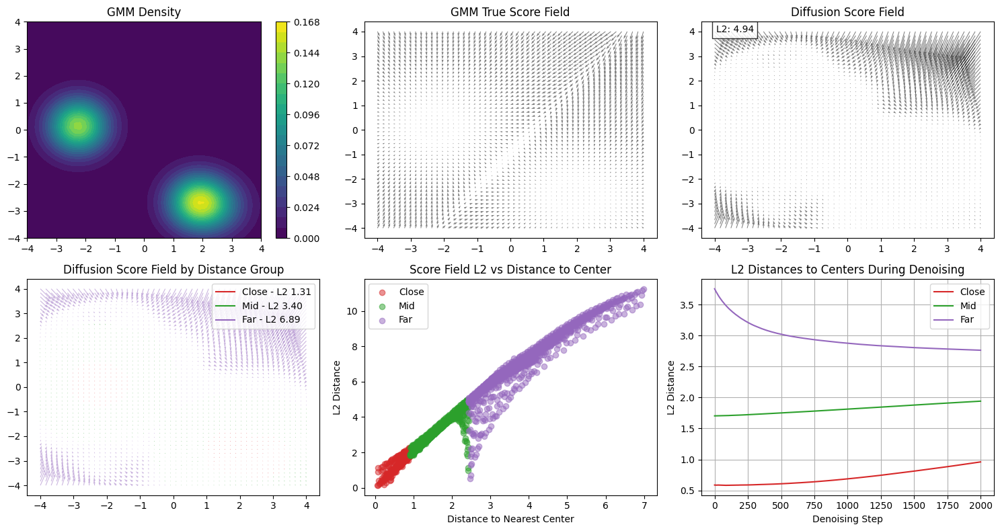

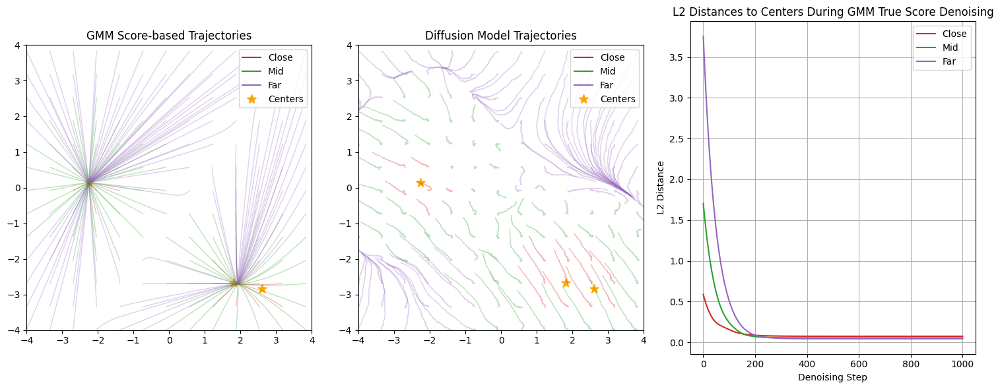

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d']['mus']
covs = gmm_params['2d']['covs']
weights = gmm_params['2d']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/gaussian/noise_scale_001_01PointUNet_denoising/gmm_new_2d/100000/denoiser_epoch_10.pt'
model_noise_type = 'gaussian'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.4335
Iteration 100: sigma=0.2132
Iteration 200: sigma=0.1309
Iteration 300: sigma=0.0920
Iteration 400: sigma=0.0724
Iteration 500: sigma=0.0592
Iteration 600: sigma=0.0505
Iteration 700: sigma=0.0449
Iteration 800: sigma=0.0419
Iteration 900: sigma=0.0404
Iteration 1000: sigma=0.0394
Iteration 1100: sigma=0.0383
Iteration 1200: sigma=0.0370
Iteration 1300: sigma=0.0358
Iteration 1400: sigma=0.0348
Iteration 1500: sigma=0.0339
Iteration 1600: sigma=0.0329
Iteration 1700: sigma=0.0319
Iteration 1800: sigma=0.0309
Iteration 1900: sigma=0.0298
Iteration 2000: sigma=0.0289
Final sigma: 0.0289, total iterations: 2000
Avg time per iteration: 0.1083 s
Iteration 1: sigma=0.4335
Iteration 100: sigma=0.2130
Iteration 200: sigma=0.1309
Iteration 300: sigma=0.0917
Iteration 400: sigma=0.0721
Iteration 500: sigma=0.0589
Iteration 600: sigma=0.0501
Iteration 700: sigma=0.0446
Iteration 800: sigma=0.0418
Iteration 900: sigma=0.0403
Iteration 1000: sigma=0.0393
Iteration 1100: sig

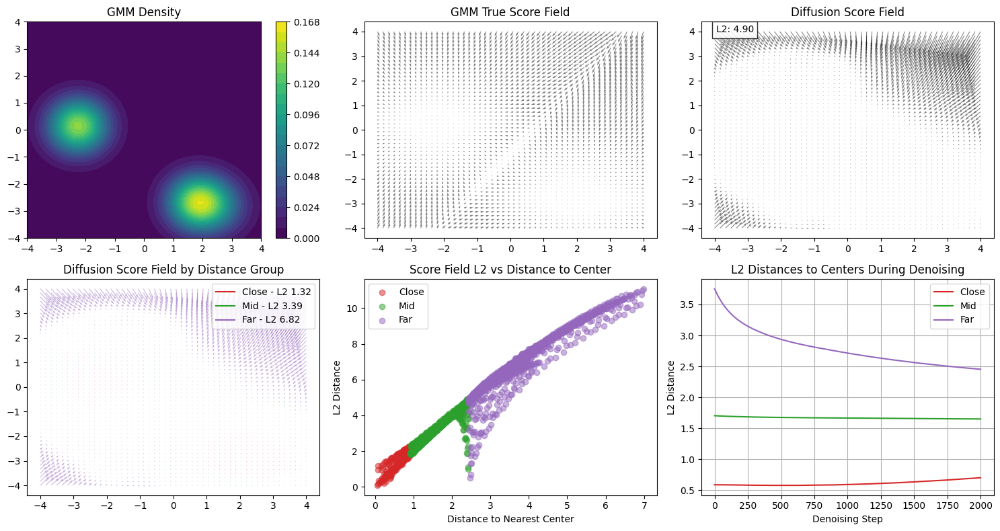

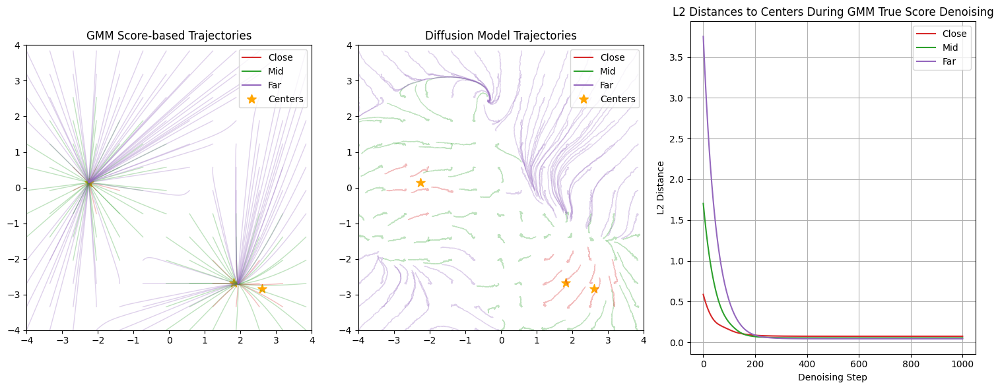

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d']['mus']
covs = gmm_params['2d']['covs']
weights = gmm_params['2d']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/gaussian/noise_scale_01_1PointUNet_denoising/gmm_new_2d/100000/denoiser_epoch_10.pt'
model_noise_type = 'gaussian'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=1.2378
Iteration 100: sigma=0.5917
Iteration 200: sigma=0.3221
Iteration 300: sigma=0.2004
Iteration 400: sigma=0.1370
Iteration 500: sigma=0.0979
Iteration 600: sigma=0.0717
Iteration 700: sigma=0.0530
Iteration 800: sigma=0.0393
Iteration 900: sigma=0.0292
Iteration 1000: sigma=0.0216
Iteration 1100: sigma=0.0158
Iteration 1200: sigma=0.0116
Final sigma: 0.0100, total iterations: 1251
Avg time per iteration: 0.1111 s
Iteration 1: sigma=1.2378
Iteration 100: sigma=0.5903
Iteration 200: sigma=0.3221
Iteration 300: sigma=0.2007
Iteration 400: sigma=0.1371
Iteration 500: sigma=0.0983
Iteration 600: sigma=0.0720
Iteration 700: sigma=0.0532
Iteration 800: sigma=0.0394
Iteration 900: sigma=0.0293
Iteration 1000: sigma=0.0217
Iteration 1100: sigma=0.0159
Iteration 1200: sigma=0.0117
Final sigma: 0.0100, total iterations: 1253
Avg time per iteration: 0.1093 s


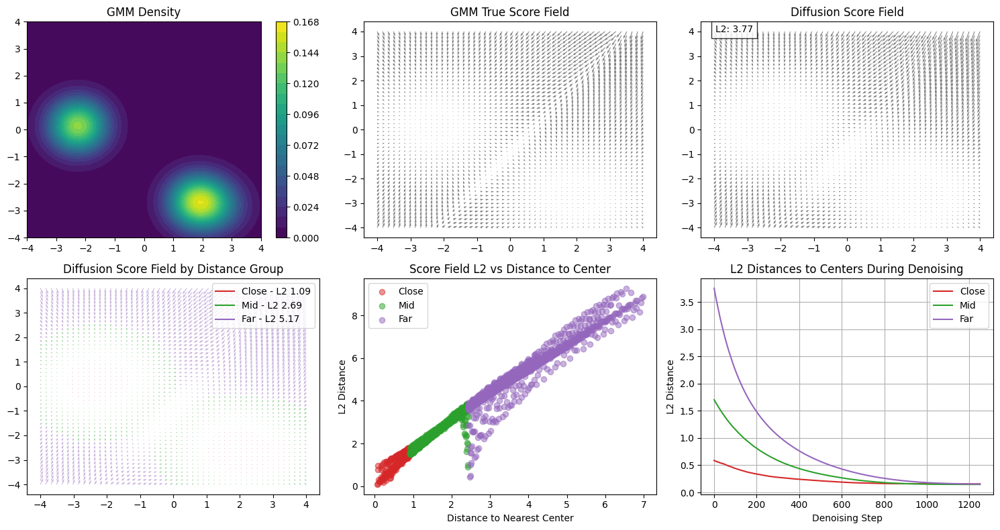

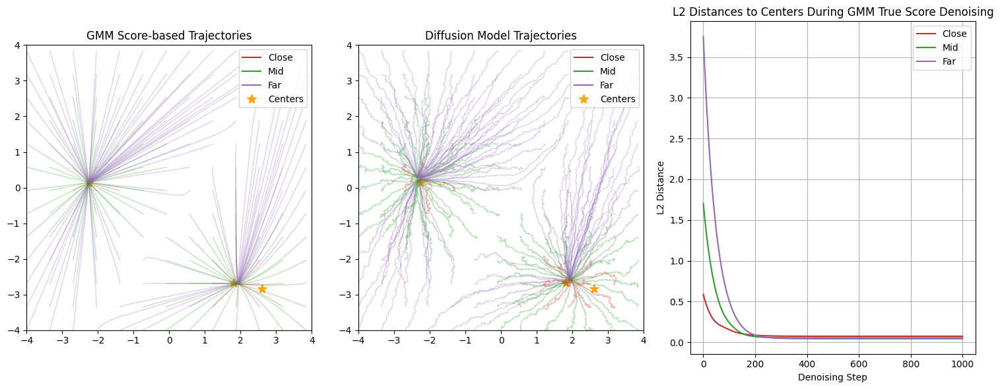

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d']['mus']
covs = gmm_params['2d']['covs']
weights = gmm_params['2d']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/gaussian/noise_scale_1_10PointUNet_denoising/gmm_new_2d/100000/denoiser_epoch_10.pt'
model_noise_type = 'gaussian'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=1.2519
Iteration 100: sigma=0.5927
Iteration 200: sigma=0.3188
Iteration 300: sigma=0.1982
Iteration 400: sigma=0.1352
Iteration 500: sigma=0.0984
Iteration 600: sigma=0.0743
Iteration 700: sigma=0.0566
Iteration 800: sigma=0.0432
Iteration 900: sigma=0.0333
Iteration 1000: sigma=0.0259
Iteration 1100: sigma=0.0202
Iteration 1200: sigma=0.0157
Iteration 1300: sigma=0.0121
Final sigma: 0.0100, total iterations: 1377
Avg time per iteration: 0.1240 s
Iteration 1: sigma=1.2519
Iteration 100: sigma=0.5941
Iteration 200: sigma=0.3191
Iteration 300: sigma=0.1988
Iteration 400: sigma=0.1356
Iteration 500: sigma=0.0986
Iteration 600: sigma=0.0745
Iteration 700: sigma=0.0567
Iteration 800: sigma=0.0433
Iteration 900: sigma=0.0333
Iteration 1000: sigma=0.0259
Iteration 1100: sigma=0.0202
Iteration 1200: sigma=0.0156
Iteration 1300: sigma=0.0121
Final sigma: 0.0100, total iterations: 1376
Avg time per iteration: 0.1111 s


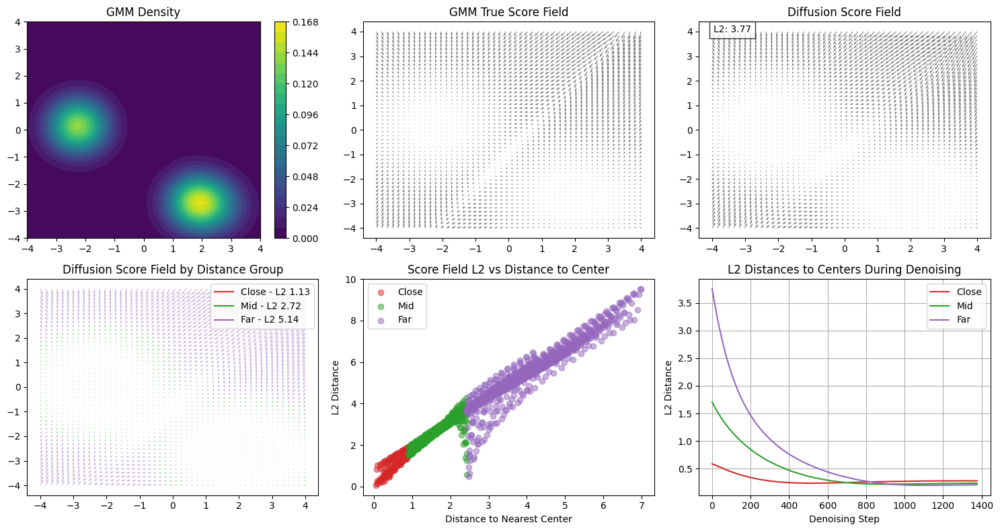

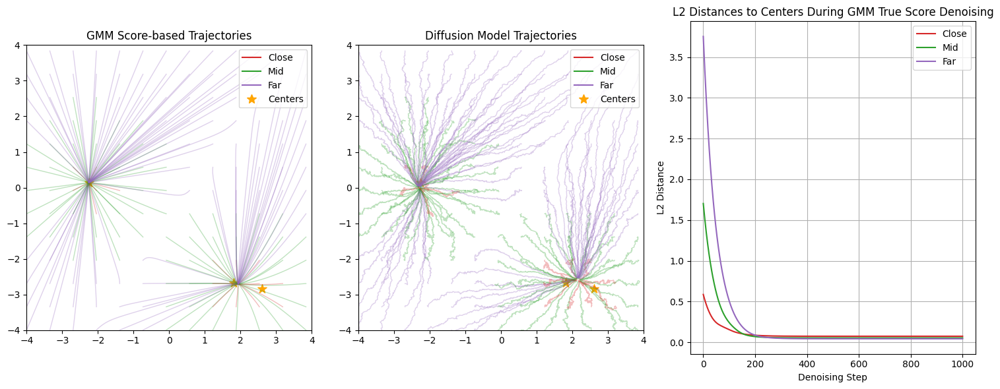

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d']['mus']
covs = gmm_params['2d']['covs']
weights = gmm_params['2d']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/gaussian/noise_scale_0001_10PointUNet_denoising/gmm_new_2d/100000/denoiser_epoch_10.pt'
model_noise_type = 'gaussian'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.5016
Iteration 100: sigma=0.2218
Iteration 200: sigma=0.1285
Iteration 300: sigma=0.0927
Iteration 400: sigma=0.0758
Iteration 500: sigma=0.0660
Iteration 600: sigma=0.0596
Iteration 700: sigma=0.0553
Iteration 800: sigma=0.0520
Iteration 900: sigma=0.0488
Iteration 1000: sigma=0.0456
Iteration 1100: sigma=0.0429
Iteration 1200: sigma=0.0402
Iteration 1300: sigma=0.0378
Iteration 1400: sigma=0.0356
Iteration 1500: sigma=0.0333
Iteration 1600: sigma=0.0313
Iteration 1700: sigma=0.0291
Iteration 1800: sigma=0.0272
Iteration 1900: sigma=0.0258
Iteration 2000: sigma=0.0243
Final sigma: 0.0243, total iterations: 2000
Avg time per iteration: 0.1123 s
Iteration 1: sigma=0.5016
Iteration 100: sigma=0.2211
Iteration 200: sigma=0.1282
Iteration 300: sigma=0.0925
Iteration 400: sigma=0.0754
Iteration 500: sigma=0.0658
Iteration 600: sigma=0.0594
Iteration 700: sigma=0.0551
Iteration 800: sigma=0.0519
Iteration 900: sigma=0.0488
Iteration 1000: sigma=0.0455
Iteration 1100: sig

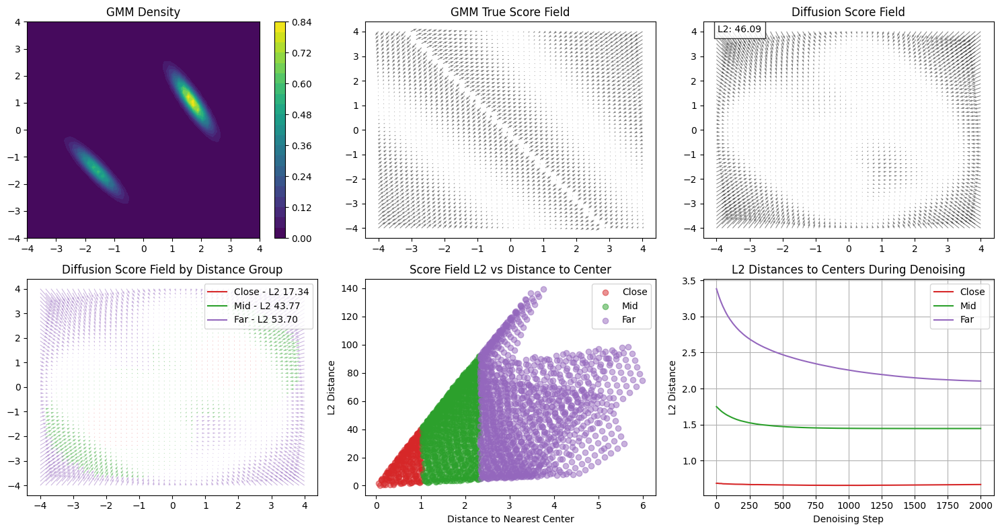

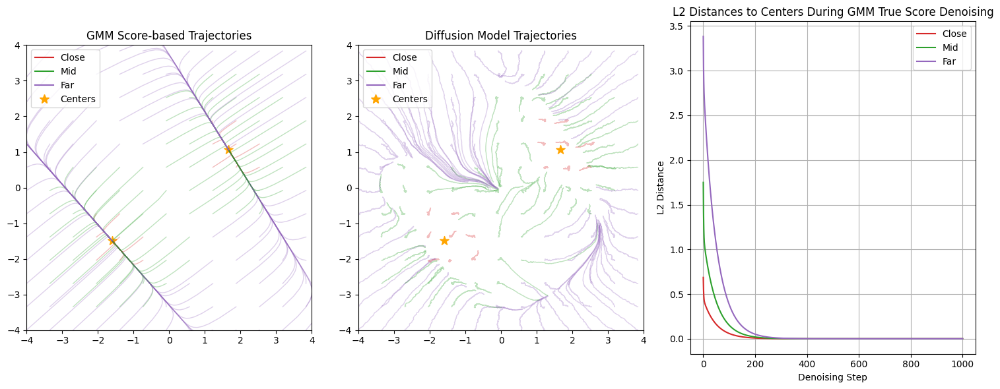

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d_sharp']['mus']
covs = gmm_params['2d_sharp']['covs']
weights = gmm_params['2d_sharp']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/gaussian/noise_scale_0001_001PointUNet_denoising/gmm_new_2d/very_sharp/100000/denoiser_epoch_10.pt'
model_noise_type = 'gaussian'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.5321
Iteration 100: sigma=0.2867
Iteration 200: sigma=0.1976
Iteration 300: sigma=0.1477
Iteration 400: sigma=0.1121
Iteration 500: sigma=0.0891
Iteration 600: sigma=0.0732
Iteration 700: sigma=0.0620
Iteration 800: sigma=0.0518
Iteration 900: sigma=0.0456
Iteration 1000: sigma=0.0394
Iteration 1100: sigma=0.0348
Iteration 1200: sigma=0.0349
Iteration 1300: sigma=0.0353
Iteration 1400: sigma=0.0351
Iteration 1500: sigma=0.0368
Iteration 1600: sigma=0.0343
Iteration 1700: sigma=0.0298
Iteration 1800: sigma=0.0265
Iteration 1900: sigma=0.0259
Iteration 2000: sigma=0.0244
Final sigma: 0.0244, total iterations: 2000
Avg time per iteration: 0.1108 s
Iteration 1: sigma=0.5321
Iteration 100: sigma=0.2855
Iteration 200: sigma=0.1975
Iteration 300: sigma=0.1484
Iteration 400: sigma=0.1132
Iteration 500: sigma=0.0877
Iteration 600: sigma=0.0714
Iteration 700: sigma=0.0594
Iteration 800: sigma=0.0528
Iteration 900: sigma=0.0475
Iteration 1000: sigma=0.0432
Iteration 1100: sig

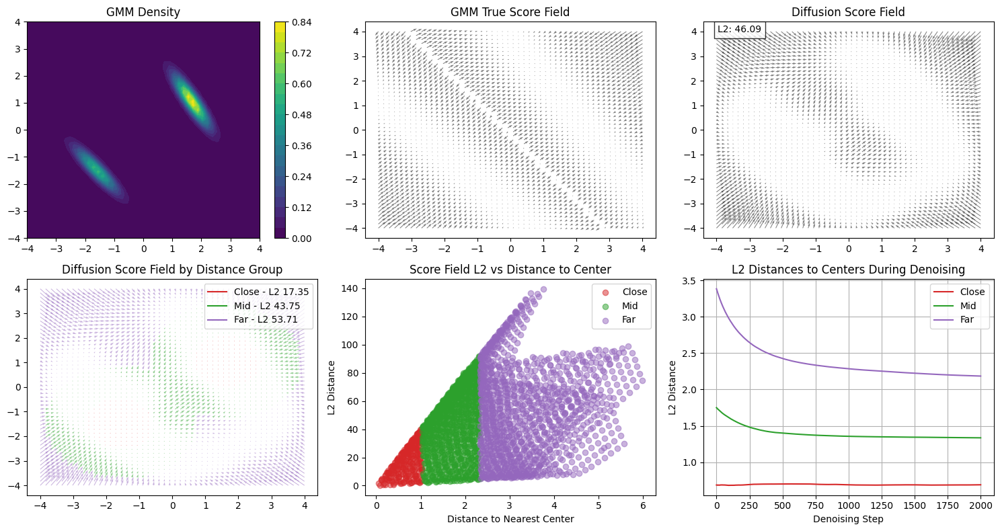

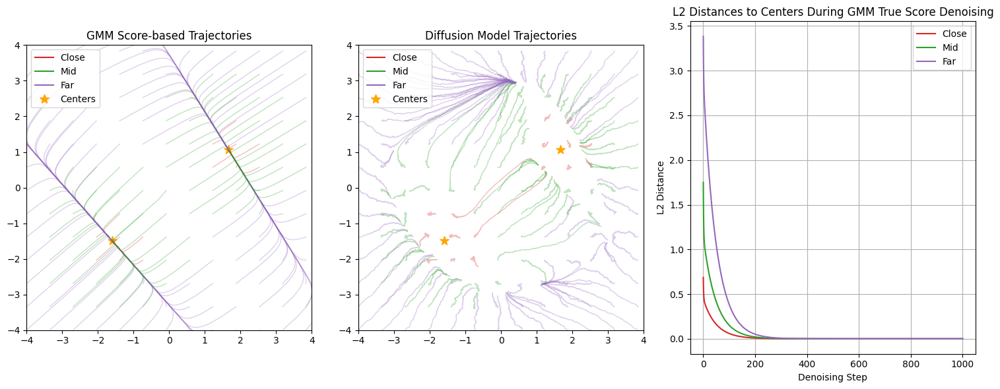

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d_sharp']['mus']
covs = gmm_params['2d_sharp']['covs']
weights = gmm_params['2d_sharp']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/gaussian/noise_scale_001_01PointUNet_denoising/gmm_new_2d/very_sharp/100000/denoiser_epoch_10.pt'
model_noise_type = 'gaussian'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.5879
Iteration 100: sigma=0.2780
Iteration 200: sigma=0.1864
Iteration 300: sigma=0.1404
Iteration 400: sigma=0.1089
Iteration 500: sigma=0.0859
Iteration 600: sigma=0.0697
Iteration 700: sigma=0.0607
Iteration 800: sigma=0.0520
Iteration 900: sigma=0.0451
Iteration 1000: sigma=0.0406
Iteration 1100: sigma=0.0362
Iteration 1200: sigma=0.0330
Iteration 1300: sigma=0.0305
Iteration 1400: sigma=0.0275
Iteration 1500: sigma=0.0250
Iteration 1600: sigma=0.0230
Iteration 1700: sigma=0.0215
Iteration 1800: sigma=0.0204
Iteration 1900: sigma=0.0194
Iteration 2000: sigma=0.0184
Final sigma: 0.0184, total iterations: 2000
Avg time per iteration: 0.1100 s
Iteration 1: sigma=0.5879
Iteration 100: sigma=0.2785
Iteration 200: sigma=0.1868
Iteration 300: sigma=0.1409
Iteration 400: sigma=0.1090
Iteration 500: sigma=0.0868
Iteration 600: sigma=0.0709
Iteration 700: sigma=0.0584
Iteration 800: sigma=0.0498
Iteration 900: sigma=0.0440
Iteration 1000: sigma=0.0399
Iteration 1100: sig

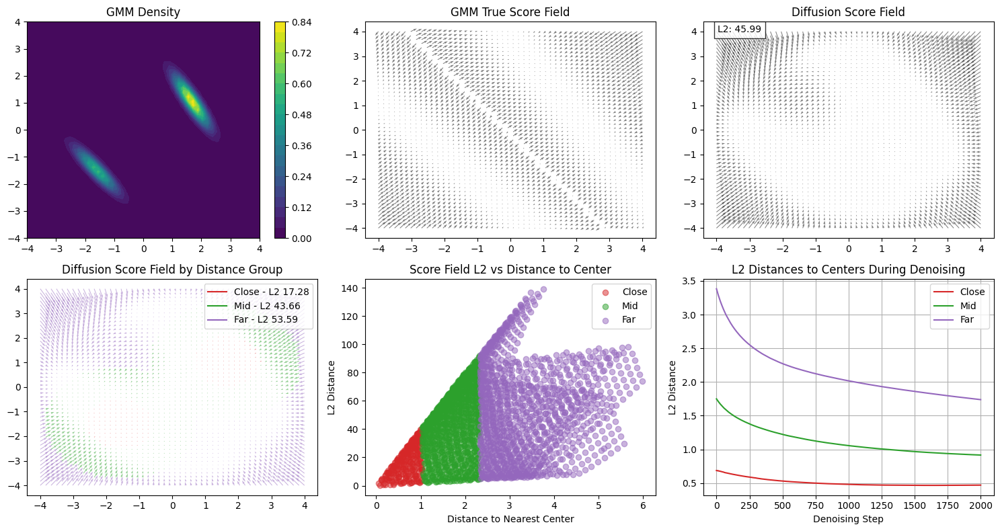

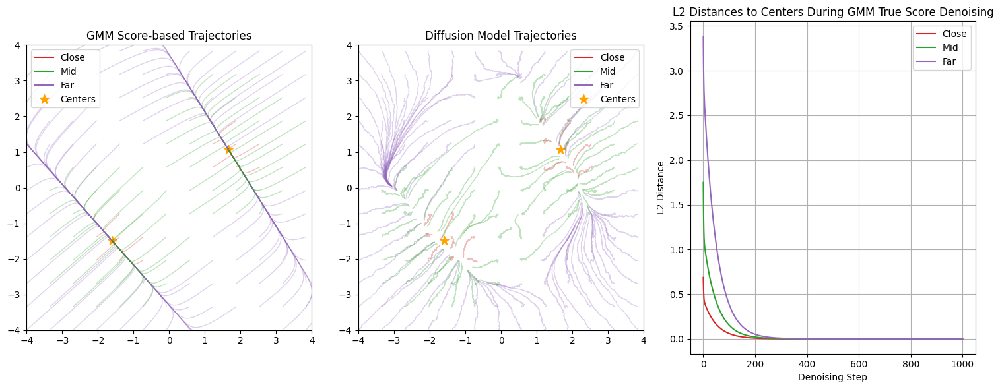

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d_sharp']['mus']
covs = gmm_params['2d_sharp']['covs']
weights = gmm_params['2d_sharp']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/gaussian/noise_scale_01_1PointUNet_denoising/gmm_new_2d/very_sharp/100000/denoiser_epoch_10.pt'
model_noise_type = 'gaussian'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=1.2983
Iteration 100: sigma=0.5849
Iteration 200: sigma=0.2696
Iteration 300: sigma=0.1497
Iteration 400: sigma=0.0985
Iteration 500: sigma=0.0711
Iteration 600: sigma=0.0542
Iteration 700: sigma=0.0423
Iteration 800: sigma=0.0335
Iteration 900: sigma=0.0267
Iteration 1000: sigma=0.0215
Iteration 1100: sigma=0.0175
Iteration 1200: sigma=0.0142
Iteration 1300: sigma=0.0117
Final sigma: 0.0100, total iterations: 1378
Avg time per iteration: 0.1091 s
Iteration 1: sigma=1.2983
Iteration 100: sigma=0.5851
Iteration 200: sigma=0.2697
Iteration 300: sigma=0.1496
Iteration 400: sigma=0.0986
Iteration 500: sigma=0.0711
Iteration 600: sigma=0.0542
Iteration 700: sigma=0.0423
Iteration 800: sigma=0.0334
Iteration 900: sigma=0.0266
Iteration 1000: sigma=0.0215
Iteration 1100: sigma=0.0174
Iteration 1200: sigma=0.0142
Iteration 1300: sigma=0.0117
Final sigma: 0.0100, total iterations: 1378
Avg time per iteration: 0.1075 s


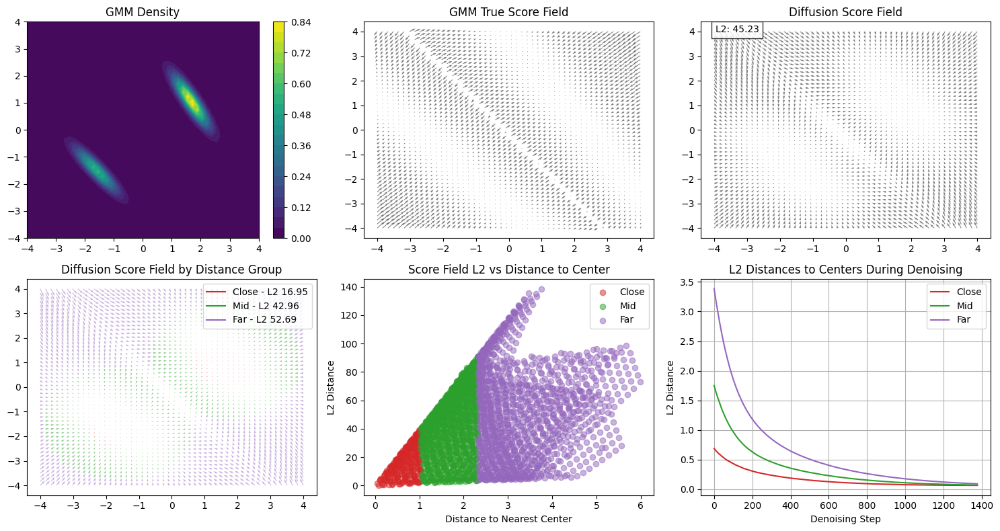

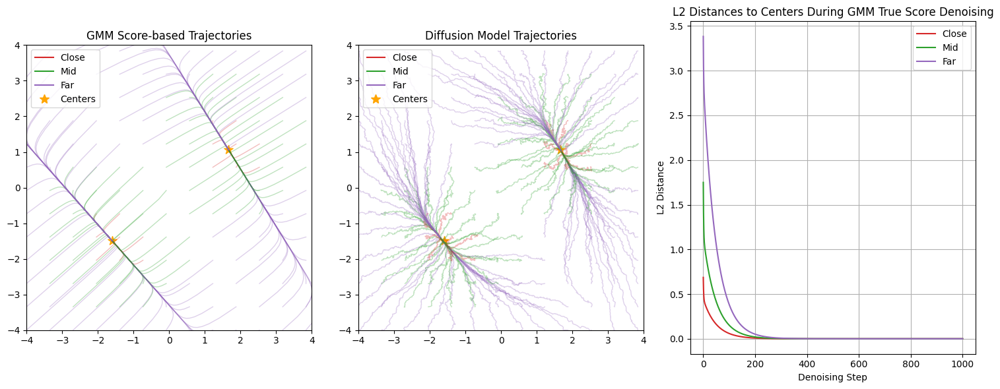

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d_sharp']['mus']
covs = gmm_params['2d_sharp']['covs']
weights = gmm_params['2d_sharp']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/gaussian/noise_scale_1_10PointUNet_denoising/gmm_new_2d/very_sharp/100000/denoiser_epoch_10.pt'
model_noise_type = 'gaussian'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.4996
Iteration 100: sigma=0.1945
Iteration 200: sigma=0.0867
Iteration 300: sigma=0.0491
Iteration 400: sigma=0.0353
Iteration 500: sigma=0.0295
Iteration 600: sigma=0.0263
Iteration 700: sigma=0.0243
Iteration 800: sigma=0.0226
Iteration 900: sigma=0.0210
Iteration 1000: sigma=0.0197
Iteration 1100: sigma=0.0184
Iteration 1200: sigma=0.0173
Iteration 1300: sigma=0.0163
Iteration 1400: sigma=0.0154
Iteration 1500: sigma=0.0146
Iteration 1600: sigma=0.0138
Iteration 1700: sigma=0.0132
Iteration 1800: sigma=0.0125
Iteration 1900: sigma=0.0120
Iteration 2000: sigma=0.0115
Final sigma: 0.0115, total iterations: 2000
Avg time per iteration: 0.1133 s
Iteration 1: sigma=0.4996
Iteration 100: sigma=0.1940
Iteration 200: sigma=0.0865
Iteration 300: sigma=0.0490
Iteration 400: sigma=0.0355
Iteration 500: sigma=0.0297
Iteration 600: sigma=0.0265
Iteration 700: sigma=0.0244
Iteration 800: sigma=0.0225
Iteration 900: sigma=0.0208
Iteration 1000: sigma=0.0194
Iteration 1100: sig

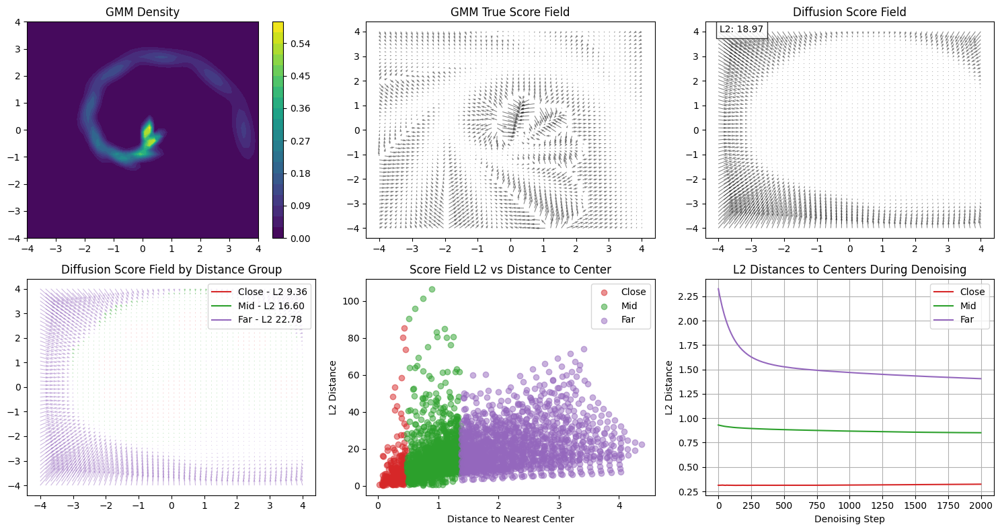

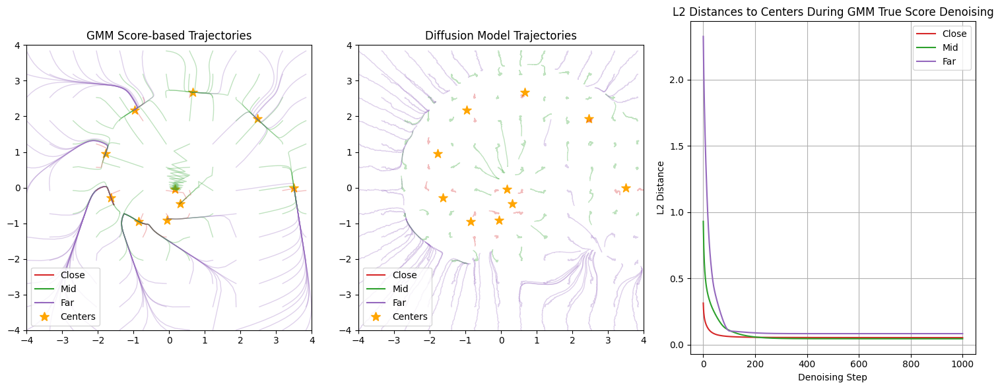

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d_spiral_2']['mus']
covs = gmm_params['2d_spiral_2']['covs']
weights = gmm_params['2d_spiral_2']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/gaussian/noise_scale_0001_001PointUNet_denoising/gmm_new_2d/spiral_2/100000/denoiser_epoch_10.pt'
model_noise_type = 'gaussian'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.4879
Iteration 100: sigma=0.1931
Iteration 200: sigma=0.0923
Iteration 300: sigma=0.0574
Iteration 400: sigma=0.0441
Iteration 500: sigma=0.0378
Iteration 600: sigma=0.0341
Iteration 700: sigma=0.0316
Iteration 800: sigma=0.0300
Iteration 900: sigma=0.0288
Iteration 1000: sigma=0.0276
Iteration 1100: sigma=0.0266
Iteration 1200: sigma=0.0257
Iteration 1300: sigma=0.0248
Iteration 1400: sigma=0.0241
Iteration 1500: sigma=0.0236
Iteration 1600: sigma=0.0231
Iteration 1700: sigma=0.0227
Iteration 1800: sigma=0.0225
Iteration 1900: sigma=0.0221
Iteration 2000: sigma=0.0216
Final sigma: 0.0216, total iterations: 2000
Avg time per iteration: 0.1080 s
Iteration 1: sigma=0.4879
Iteration 100: sigma=0.1938
Iteration 200: sigma=0.0925
Iteration 300: sigma=0.0572
Iteration 400: sigma=0.0436
Iteration 500: sigma=0.0373
Iteration 600: sigma=0.0340
Iteration 700: sigma=0.0318
Iteration 800: sigma=0.0300
Iteration 900: sigma=0.0287
Iteration 1000: sigma=0.0275
Iteration 1100: sig

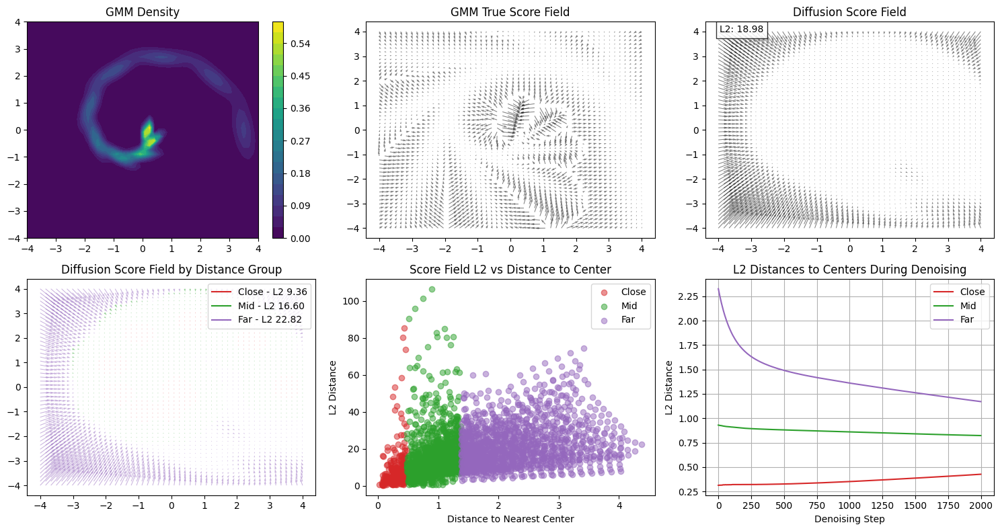

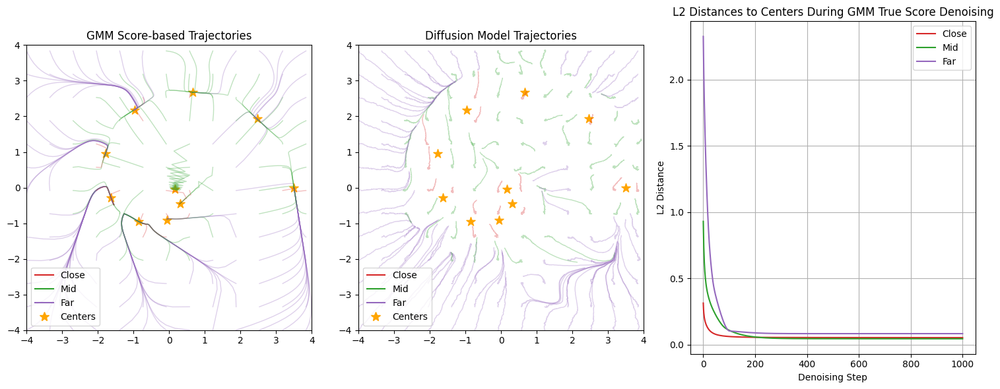

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d_spiral_2']['mus']
covs = gmm_params['2d_spiral_2']['covs']
weights = gmm_params['2d_spiral_2']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/gaussian/noise_scale_001_01PointUNet_denoising/gmm_new_2d/spiral_2/100000/denoiser_epoch_10.pt'
model_noise_type = 'gaussian'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.5152
Iteration 100: sigma=0.2020
Iteration 200: sigma=0.1003
Iteration 300: sigma=0.0649
Iteration 400: sigma=0.0502
Iteration 500: sigma=0.0425
Iteration 600: sigma=0.0379
Iteration 700: sigma=0.0348
Iteration 800: sigma=0.0326
Iteration 900: sigma=0.0306
Iteration 1000: sigma=0.0288
Iteration 1100: sigma=0.0271
Iteration 1200: sigma=0.0256
Iteration 1300: sigma=0.0241
Iteration 1400: sigma=0.0228
Iteration 1500: sigma=0.0216
Iteration 1600: sigma=0.0205
Iteration 1700: sigma=0.0194
Iteration 1800: sigma=0.0186
Iteration 1900: sigma=0.0179
Iteration 2000: sigma=0.0172
Final sigma: 0.0172, total iterations: 2000
Avg time per iteration: 0.1110 s
Iteration 1: sigma=0.5152
Iteration 100: sigma=0.2015
Iteration 200: sigma=0.1004
Iteration 300: sigma=0.0649
Iteration 400: sigma=0.0504
Iteration 500: sigma=0.0430
Iteration 600: sigma=0.0384
Iteration 700: sigma=0.0350
Iteration 800: sigma=0.0325
Iteration 900: sigma=0.0305
Iteration 1000: sigma=0.0287
Iteration 1100: sig

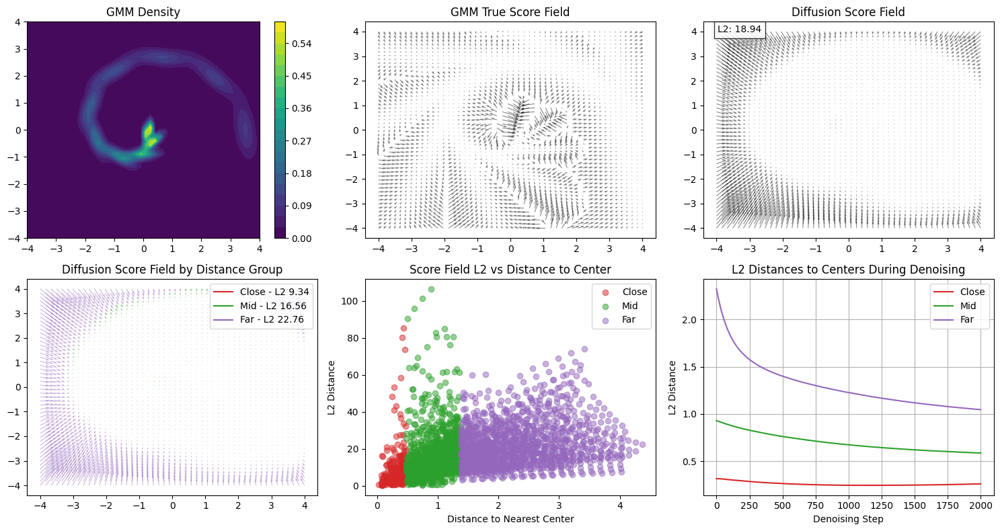

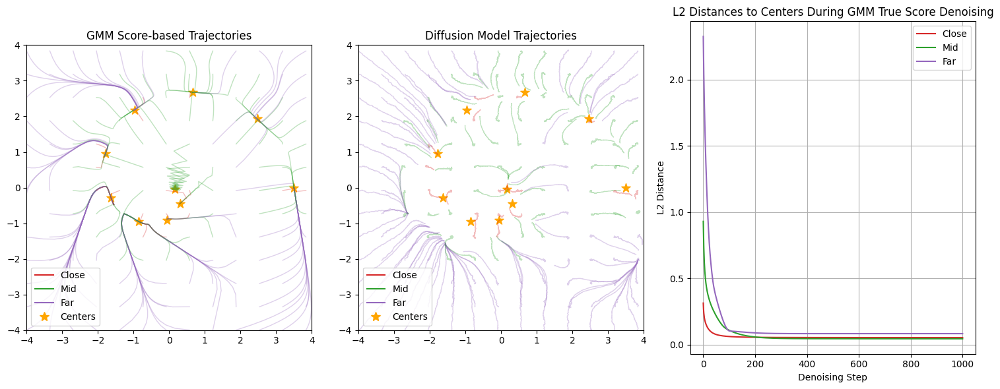

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d_spiral_2']['mus']
covs = gmm_params['2d_spiral_2']['covs']
weights = gmm_params['2d_spiral_2']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/gaussian/noise_scale_01_1PointUNet_denoising/gmm_new_2d/spiral_2/100000/denoiser_epoch_10.pt'
model_noise_type = 'gaussian'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=1.0891
Iteration 100: sigma=0.4552
Iteration 200: sigma=0.2042
Iteration 300: sigma=0.1116
Iteration 400: sigma=0.0811
Iteration 500: sigma=0.0699
Iteration 600: sigma=0.0645
Iteration 700: sigma=0.0611
Iteration 800: sigma=0.0584
Iteration 900: sigma=0.0560
Iteration 1000: sigma=0.0536
Iteration 1100: sigma=0.0512
Iteration 1200: sigma=0.0486
Iteration 1300: sigma=0.0464
Iteration 1400: sigma=0.0445
Iteration 1500: sigma=0.0426
Iteration 1600: sigma=0.0407
Iteration 1700: sigma=0.0390
Iteration 1800: sigma=0.0370
Iteration 1900: sigma=0.0350
Iteration 2000: sigma=0.0332
Final sigma: 0.0332, total iterations: 2000
Avg time per iteration: 0.1092 s
Iteration 1: sigma=1.0891
Iteration 100: sigma=0.4568
Iteration 200: sigma=0.2041
Iteration 300: sigma=0.1120
Iteration 400: sigma=0.0811
Iteration 500: sigma=0.0702
Iteration 600: sigma=0.0649
Iteration 700: sigma=0.0614
Iteration 800: sigma=0.0585
Iteration 900: sigma=0.0560
Iteration 1000: sigma=0.0538
Iteration 1100: sig

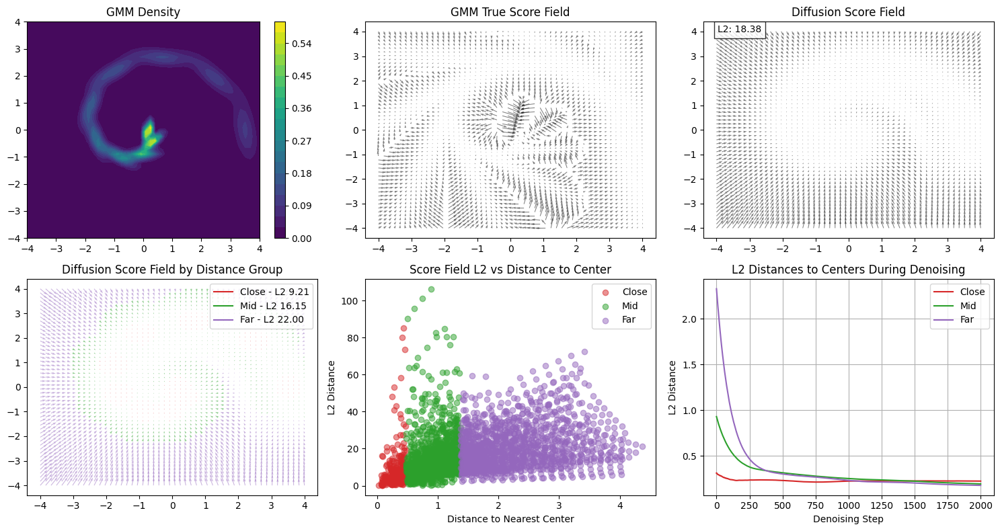

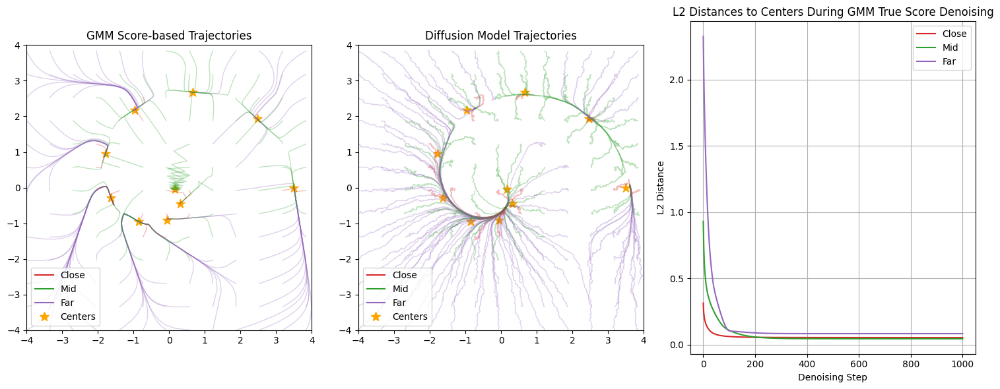

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d_spiral_2']['mus']
covs = gmm_params['2d_spiral_2']['covs']
weights = gmm_params['2d_spiral_2']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/gaussian/noise_scale_1_10PointUNet_denoising/gmm_new_2d/spiral_2/100000/denoiser_epoch_10.pt'
model_noise_type = 'gaussian'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.3497
Iteration 100: sigma=0.1864
Iteration 200: sigma=0.1253
Iteration 300: sigma=0.0912
Iteration 400: sigma=0.0709
Iteration 500: sigma=0.0582
Iteration 600: sigma=0.0499
Iteration 700: sigma=0.0439
Iteration 800: sigma=0.0395
Iteration 900: sigma=0.0355
Iteration 1000: sigma=0.0324
Iteration 1100: sigma=0.0301
Iteration 1200: sigma=0.0283
Iteration 1300: sigma=0.0266
Iteration 1400: sigma=0.0248
Iteration 1500: sigma=0.0230
Iteration 1600: sigma=0.0218
Iteration 1700: sigma=0.0209
Iteration 1800: sigma=0.0202
Iteration 1900: sigma=0.0195
Iteration 2000: sigma=0.0187
Final sigma: 0.0187, total iterations: 2000
Avg time per iteration: 0.1086 s
Iteration 1: sigma=0.3497
Iteration 100: sigma=0.1863
Iteration 200: sigma=0.1254
Iteration 300: sigma=0.0912
Iteration 400: sigma=0.0710
Iteration 500: sigma=0.0583
Iteration 600: sigma=0.0499
Iteration 700: sigma=0.0438
Iteration 800: sigma=0.0395
Iteration 900: sigma=0.0356
Iteration 1000: sigma=0.0326
Iteration 1100: sig

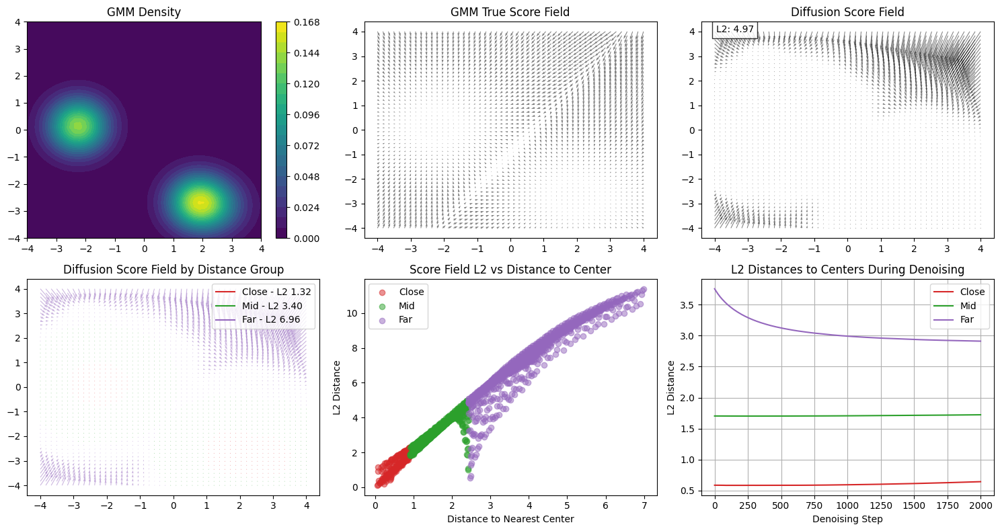

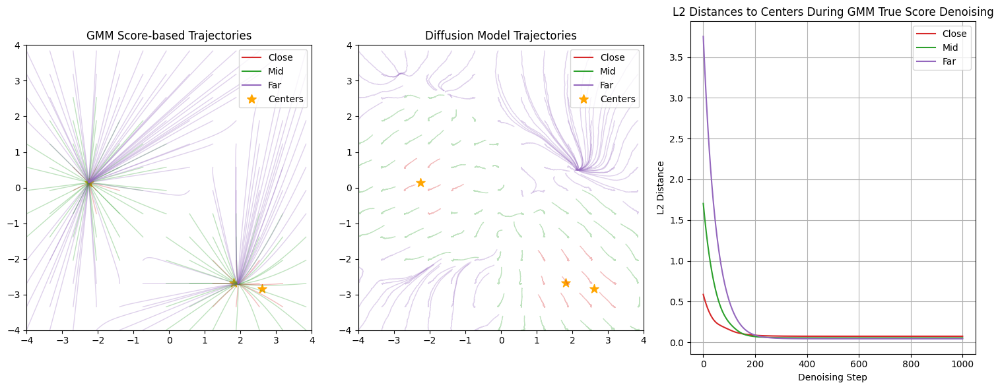

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d']['mus']
covs = gmm_params['2d']['covs']
weights = gmm_params['2d']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/uniform/noise_scale_0001_001PointUNet_denoising/gmm_new_2d/100000/denoiser_epoch_10.pt'
model_noise_type = 'uniform'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.4612
Iteration 100: sigma=0.1780
Iteration 200: sigma=0.1171
Iteration 300: sigma=0.0896
Iteration 400: sigma=0.0727
Iteration 500: sigma=0.0606
Iteration 600: sigma=0.0513
Iteration 700: sigma=0.0441
Iteration 800: sigma=0.0384
Iteration 900: sigma=0.0338
Iteration 1000: sigma=0.0302
Iteration 1100: sigma=0.0272
Iteration 1200: sigma=0.0249
Iteration 1300: sigma=0.0231
Iteration 1400: sigma=0.0215
Iteration 1500: sigma=0.0203
Iteration 1600: sigma=0.0194
Iteration 1700: sigma=0.0188
Iteration 1800: sigma=0.0183
Iteration 1900: sigma=0.0179
Iteration 2000: sigma=0.0175
Final sigma: 0.0175, total iterations: 2000
Avg time per iteration: 0.1064 s
Iteration 1: sigma=0.4612
Iteration 100: sigma=0.1779
Iteration 200: sigma=0.1169
Iteration 300: sigma=0.0895
Iteration 400: sigma=0.0726
Iteration 500: sigma=0.0604
Iteration 600: sigma=0.0513
Iteration 700: sigma=0.0440
Iteration 800: sigma=0.0383
Iteration 900: sigma=0.0338
Iteration 1000: sigma=0.0300
Iteration 1100: sig

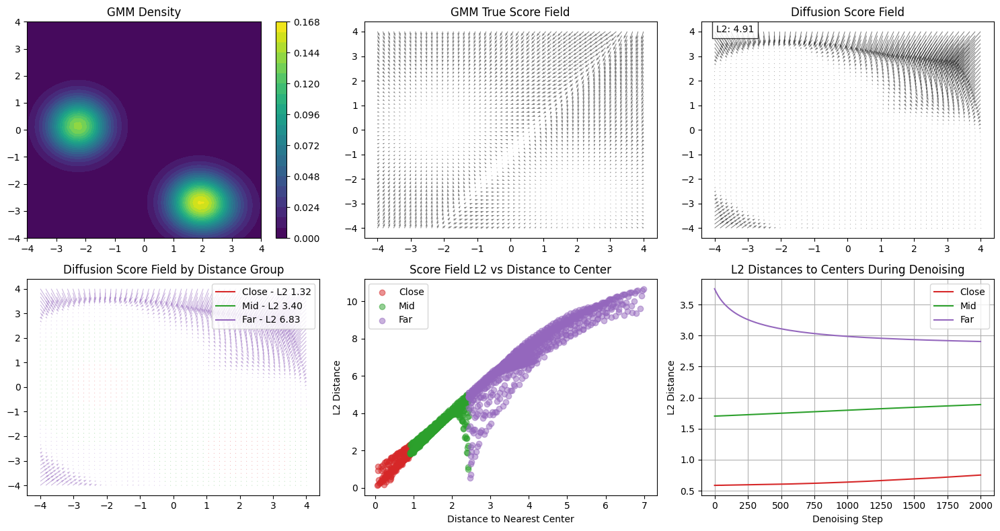

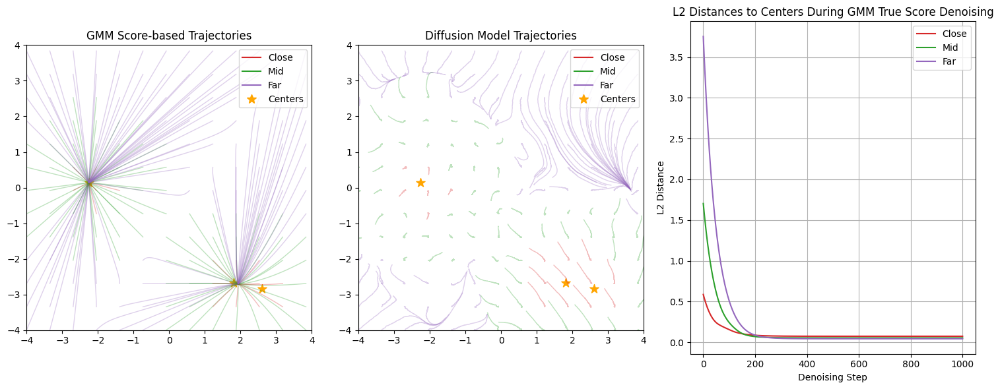

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d']['mus']
covs = gmm_params['2d']['covs']
weights = gmm_params['2d']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/uniform/noise_scale_001_01PointUNet_denoising/gmm_new_2d/100000/denoiser_epoch_10.pt'
model_noise_type = 'uniform'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.4576
Iteration 100: sigma=0.2225
Iteration 200: sigma=0.1425
Iteration 300: sigma=0.1100
Iteration 400: sigma=0.0908
Iteration 500: sigma=0.0762
Iteration 600: sigma=0.0651
Iteration 700: sigma=0.0574
Iteration 800: sigma=0.0518
Iteration 900: sigma=0.0474
Iteration 1000: sigma=0.0432
Iteration 1100: sigma=0.0411
Iteration 1200: sigma=0.0404
Iteration 1300: sigma=0.0397
Iteration 1400: sigma=0.0394
Iteration 1500: sigma=0.0396
Iteration 1600: sigma=0.0399
Iteration 1700: sigma=0.0403
Iteration 1800: sigma=0.0397
Iteration 1900: sigma=0.0384
Iteration 2000: sigma=0.0377
Final sigma: 0.0377, total iterations: 2000
Avg time per iteration: 0.1086 s
Iteration 1: sigma=0.4576
Iteration 100: sigma=0.2229
Iteration 200: sigma=0.1426
Iteration 300: sigma=0.1100
Iteration 400: sigma=0.0909
Iteration 500: sigma=0.0767
Iteration 600: sigma=0.0657
Iteration 700: sigma=0.0574
Iteration 800: sigma=0.0515
Iteration 900: sigma=0.0475
Iteration 1000: sigma=0.0442
Iteration 1100: sig

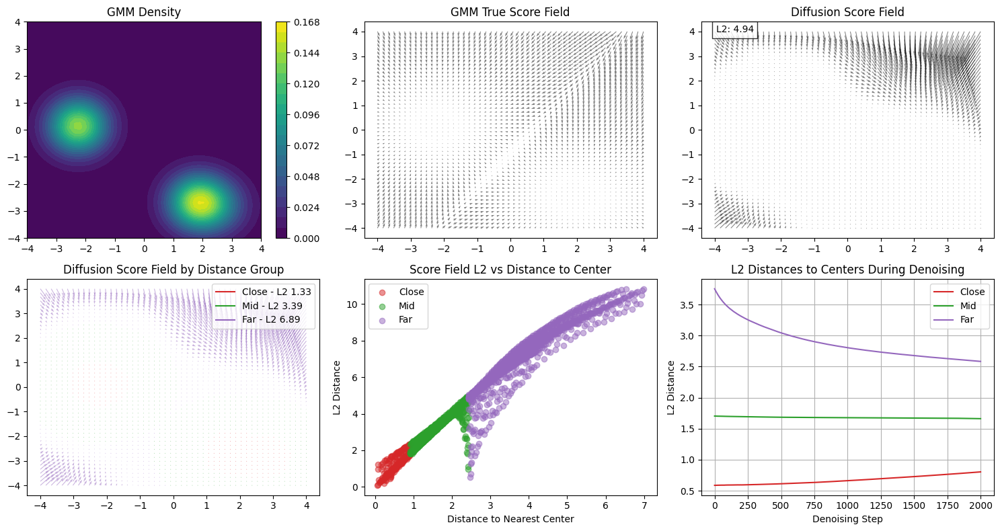

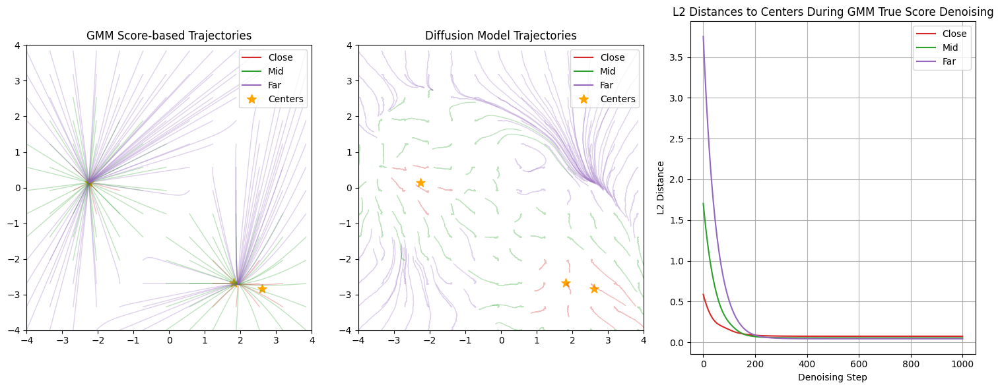

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d']['mus']
covs = gmm_params['2d']['covs']
weights = gmm_params['2d']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/uniform/noise_scale_01_1PointUNet_denoising/gmm_new_2d/100000/denoiser_epoch_10.pt'
model_noise_type = 'uniform'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.6786
Iteration 100: sigma=0.3908
Iteration 200: sigma=0.2759
Iteration 300: sigma=0.2140
Iteration 400: sigma=0.1765
Iteration 500: sigma=0.1494
Iteration 600: sigma=0.1248
Iteration 700: sigma=0.1043
Iteration 800: sigma=0.0861
Iteration 900: sigma=0.0702
Iteration 1000: sigma=0.0569
Iteration 1100: sigma=0.0468
Iteration 1200: sigma=0.0393
Iteration 1300: sigma=0.0334
Iteration 1400: sigma=0.0286
Iteration 1500: sigma=0.0246
Iteration 1600: sigma=0.0210
Iteration 1700: sigma=0.0181
Iteration 1800: sigma=0.0157
Iteration 1900: sigma=0.0135
Iteration 2000: sigma=0.0114
Final sigma: 0.0114, total iterations: 2000
Avg time per iteration: 0.1095 s
Iteration 1: sigma=0.6786
Iteration 100: sigma=0.3915
Iteration 200: sigma=0.2758
Iteration 300: sigma=0.2136
Iteration 400: sigma=0.1764
Iteration 500: sigma=0.1496
Iteration 600: sigma=0.1252
Iteration 700: sigma=0.1042
Iteration 800: sigma=0.0858
Iteration 900: sigma=0.0699
Iteration 1000: sigma=0.0567
Iteration 1100: sig

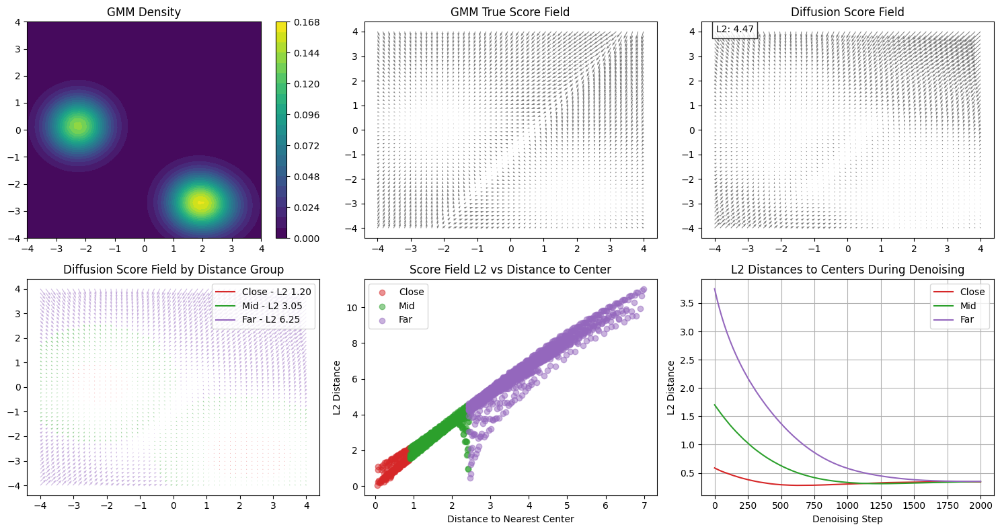

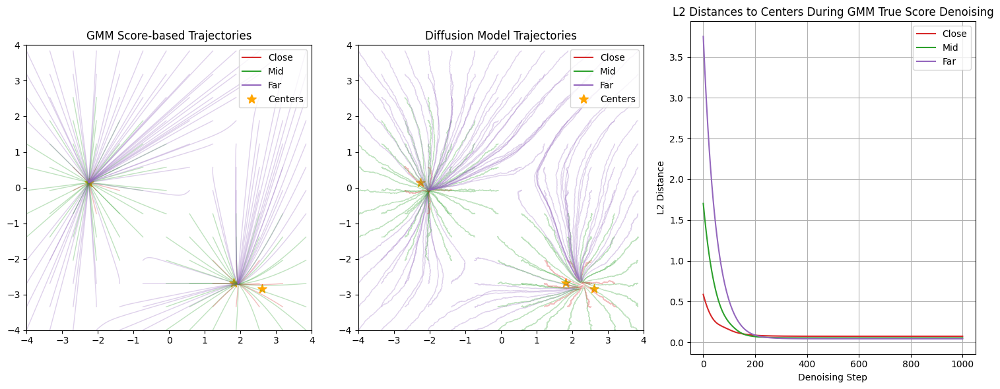

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d']['mus']
covs = gmm_params['2d']['covs']
weights = gmm_params['2d']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/uniform/noise_scale_1_10PointUNet_denoising/gmm_new_2d/100000/denoiser_epoch_10.pt'
model_noise_type = 'uniform'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.5389
Iteration 100: sigma=0.2487
Iteration 200: sigma=0.1391
Iteration 300: sigma=0.0960
Iteration 400: sigma=0.0778
Iteration 500: sigma=0.0696
Iteration 600: sigma=0.0657
Iteration 700: sigma=0.0636
Iteration 800: sigma=0.0621
Iteration 900: sigma=0.0602
Iteration 1000: sigma=0.0582
Iteration 1100: sigma=0.0557
Iteration 1200: sigma=0.0523
Iteration 1300: sigma=0.0485
Iteration 1400: sigma=0.0441
Iteration 1500: sigma=0.0392
Iteration 1600: sigma=0.0340
Iteration 1700: sigma=0.0292
Iteration 1800: sigma=0.0252
Iteration 1900: sigma=0.0219
Iteration 2000: sigma=0.0198
Final sigma: 0.0198, total iterations: 2000
Avg time per iteration: 0.1064 s
Iteration 1: sigma=0.5389
Iteration 100: sigma=0.2488
Iteration 200: sigma=0.1391
Iteration 300: sigma=0.0960
Iteration 400: sigma=0.0780
Iteration 500: sigma=0.0697
Iteration 600: sigma=0.0657
Iteration 700: sigma=0.0635
Iteration 800: sigma=0.0621
Iteration 900: sigma=0.0603
Iteration 1000: sigma=0.0582
Iteration 1100: sig

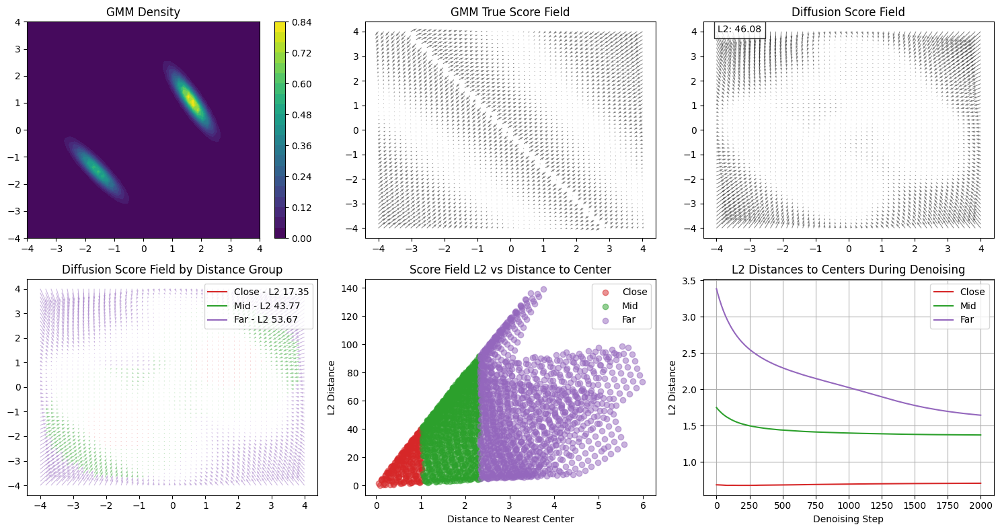

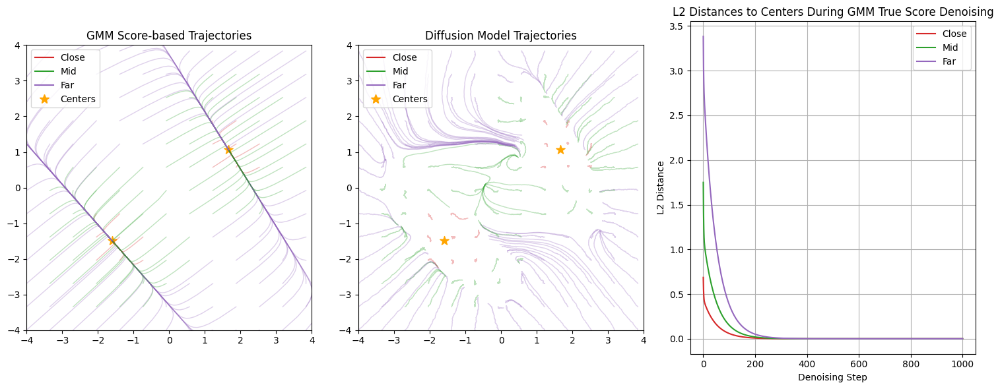

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d_sharp']['mus']
covs = gmm_params['2d_sharp']['covs']
weights = gmm_params['2d_sharp']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/uniform/noise_scale_0001_001PointUNet_denoising/gmm_new_2d/very_sharp/100000/denoiser_epoch_10.pt'
model_noise_type = 'uniform'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.4969
Iteration 100: sigma=0.2180
Iteration 200: sigma=0.1257
Iteration 300: sigma=0.0943
Iteration 400: sigma=0.0814
Iteration 500: sigma=0.0743
Iteration 600: sigma=0.0690
Iteration 700: sigma=0.0642
Iteration 800: sigma=0.0597
Iteration 900: sigma=0.0549
Iteration 1000: sigma=0.0501
Iteration 1100: sigma=0.0458
Iteration 1200: sigma=0.0420
Iteration 1300: sigma=0.0387
Iteration 1400: sigma=0.0355
Iteration 1500: sigma=0.0328
Iteration 1600: sigma=0.0310
Iteration 1700: sigma=0.0299
Iteration 1800: sigma=0.0289
Iteration 1900: sigma=0.0281
Iteration 2000: sigma=0.0279
Final sigma: 0.0279, total iterations: 2000
Avg time per iteration: 0.1047 s
Iteration 1: sigma=0.4969
Iteration 100: sigma=0.2177
Iteration 200: sigma=0.1257
Iteration 300: sigma=0.0944
Iteration 400: sigma=0.0815
Iteration 500: sigma=0.0742
Iteration 600: sigma=0.0691
Iteration 700: sigma=0.0646
Iteration 800: sigma=0.0598
Iteration 900: sigma=0.0549
Iteration 1000: sigma=0.0503
Iteration 1100: sig

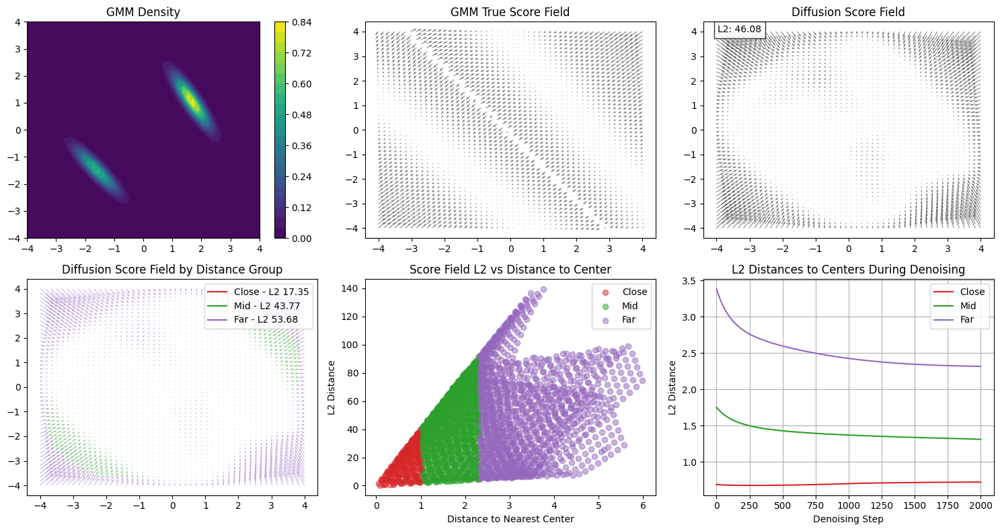

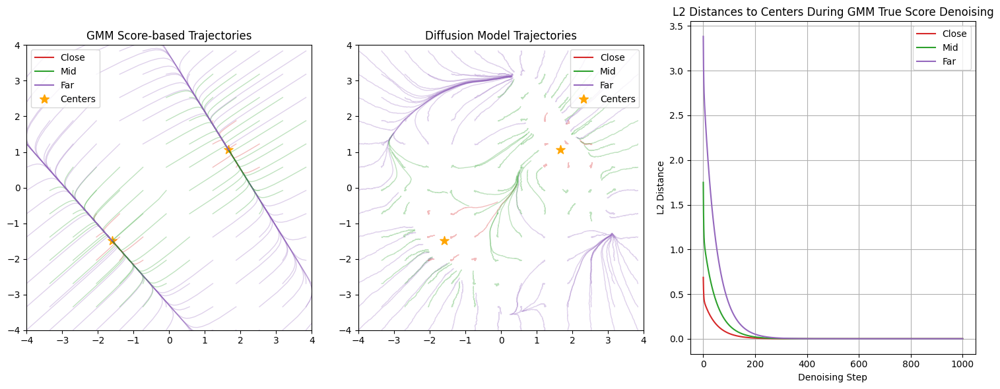

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d_sharp']['mus']
covs = gmm_params['2d_sharp']['covs']
weights = gmm_params['2d_sharp']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/uniform/noise_scale_001_01PointUNet_denoising/gmm_new_2d/very_sharp/100000/denoiser_epoch_10.pt'
model_noise_type = 'uniform'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.5254
Iteration 100: sigma=0.2200
Iteration 200: sigma=0.1276
Iteration 300: sigma=0.0938
Iteration 400: sigma=0.0770
Iteration 500: sigma=0.0666
Iteration 600: sigma=0.0596
Iteration 700: sigma=0.0550
Iteration 800: sigma=0.0515
Iteration 900: sigma=0.0485
Iteration 1000: sigma=0.0456
Iteration 1100: sigma=0.0426
Iteration 1200: sigma=0.0396
Iteration 1300: sigma=0.0369
Iteration 1400: sigma=0.0346
Iteration 1500: sigma=0.0324
Iteration 1600: sigma=0.0305
Iteration 1700: sigma=0.0287
Iteration 1800: sigma=0.0271
Iteration 1900: sigma=0.0257
Iteration 2000: sigma=0.0245
Final sigma: 0.0245, total iterations: 2000
Avg time per iteration: 0.1093 s
Iteration 1: sigma=0.5254
Iteration 100: sigma=0.2201
Iteration 200: sigma=0.1281
Iteration 300: sigma=0.0939
Iteration 400: sigma=0.0771
Iteration 500: sigma=0.0668
Iteration 600: sigma=0.0597
Iteration 700: sigma=0.0547
Iteration 800: sigma=0.0510
Iteration 900: sigma=0.0479
Iteration 1000: sigma=0.0451
Iteration 1100: sig

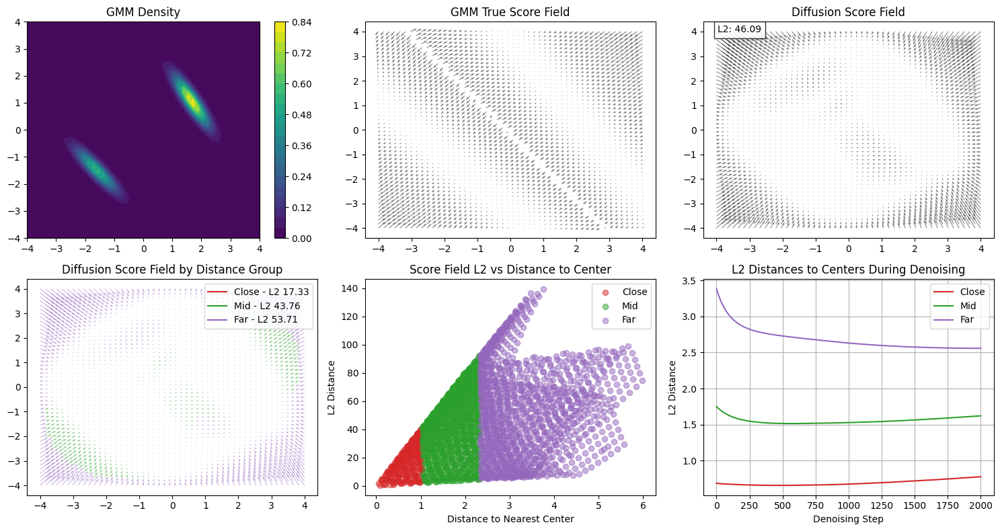

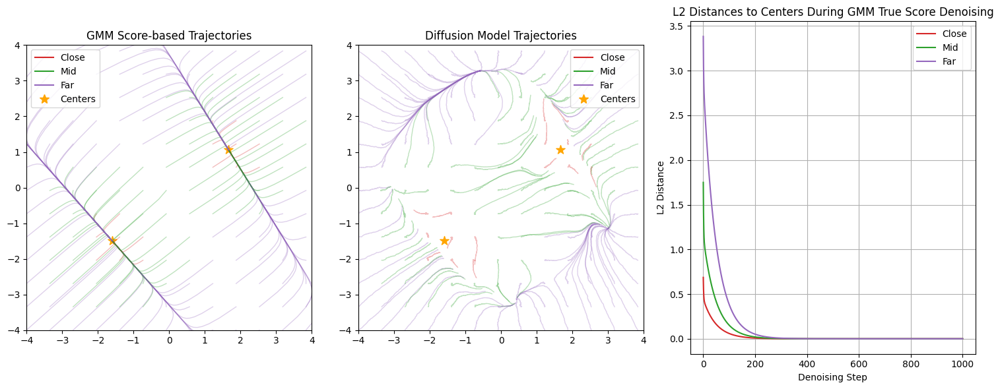

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d_sharp']['mus']
covs = gmm_params['2d_sharp']['covs']
weights = gmm_params['2d_sharp']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/uniform/noise_scale_01_1PointUNet_denoising/gmm_new_2d/very_sharp/100000/denoiser_epoch_10.pt'
model_noise_type = 'uniform'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.8514
Iteration 100: sigma=0.4324
Iteration 200: sigma=0.2797
Iteration 300: sigma=0.2079
Iteration 400: sigma=0.1594
Iteration 500: sigma=0.1242
Iteration 600: sigma=0.0973
Iteration 700: sigma=0.0779
Iteration 800: sigma=0.0638
Iteration 900: sigma=0.0540
Iteration 1000: sigma=0.0457
Iteration 1100: sigma=0.0387
Iteration 1200: sigma=0.0333
Iteration 1300: sigma=0.0291
Iteration 1400: sigma=0.0260
Iteration 1500: sigma=0.0235
Iteration 1600: sigma=0.0209
Iteration 1700: sigma=0.0183
Iteration 1800: sigma=0.0160
Iteration 1900: sigma=0.0141
Iteration 2000: sigma=0.0126
Final sigma: 0.0126, total iterations: 2000
Avg time per iteration: 0.1099 s
Iteration 1: sigma=0.8514
Iteration 100: sigma=0.4325
Iteration 200: sigma=0.2793
Iteration 300: sigma=0.2071
Iteration 400: sigma=0.1596
Iteration 500: sigma=0.1241
Iteration 600: sigma=0.0968
Iteration 700: sigma=0.0777
Iteration 800: sigma=0.0638
Iteration 900: sigma=0.0540
Iteration 1000: sigma=0.0456
Iteration 1100: sig

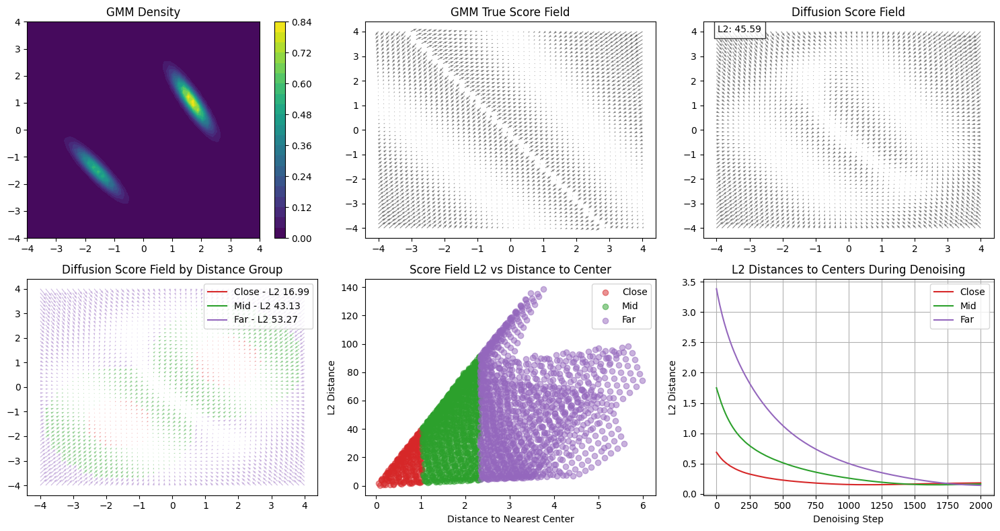

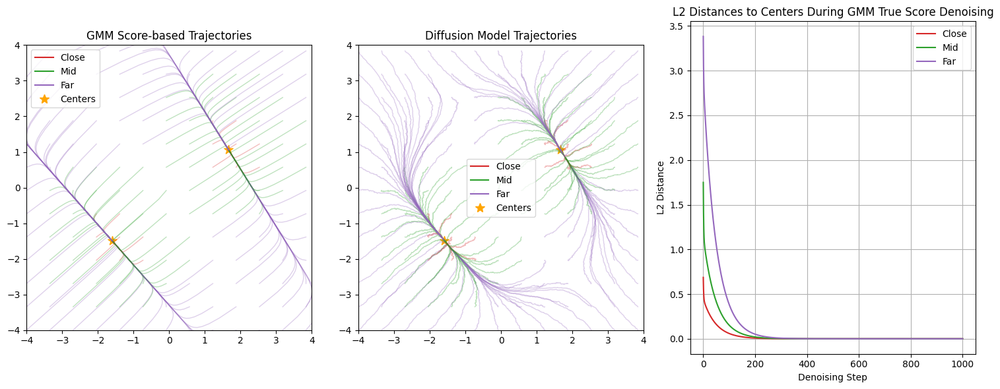

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d_sharp']['mus']
covs = gmm_params['2d_sharp']['covs']
weights = gmm_params['2d_sharp']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/uniform/noise_scale_1_10PointUNet_denoising/gmm_new_2d/very_sharp/100000/denoiser_epoch_10.pt'
model_noise_type = 'uniform'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.5259
Iteration 100: sigma=0.2219
Iteration 200: sigma=0.1243
Iteration 300: sigma=0.0874
Iteration 400: sigma=0.0698
Iteration 500: sigma=0.0605
Iteration 600: sigma=0.0545
Iteration 700: sigma=0.0505
Iteration 800: sigma=0.0462
Iteration 900: sigma=0.0439
Iteration 1000: sigma=0.0425
Iteration 1100: sigma=0.0403
Iteration 1200: sigma=0.0376
Iteration 1300: sigma=0.0347
Iteration 1400: sigma=0.0323
Iteration 1500: sigma=0.0306
Iteration 1600: sigma=0.0293
Iteration 1700: sigma=0.0280
Iteration 1800: sigma=0.0273
Iteration 1900: sigma=0.0273
Iteration 2000: sigma=0.0266
Final sigma: 0.0266, total iterations: 2000
Avg time per iteration: 0.1151 s
Iteration 1: sigma=0.5259
Iteration 100: sigma=0.2218
Iteration 200: sigma=0.1247
Iteration 300: sigma=0.0876
Iteration 400: sigma=0.0696
Iteration 500: sigma=0.0602
Iteration 600: sigma=0.0553
Iteration 700: sigma=0.0507
Iteration 800: sigma=0.0463
Iteration 900: sigma=0.0439
Iteration 1000: sigma=0.0420
Iteration 1100: sig

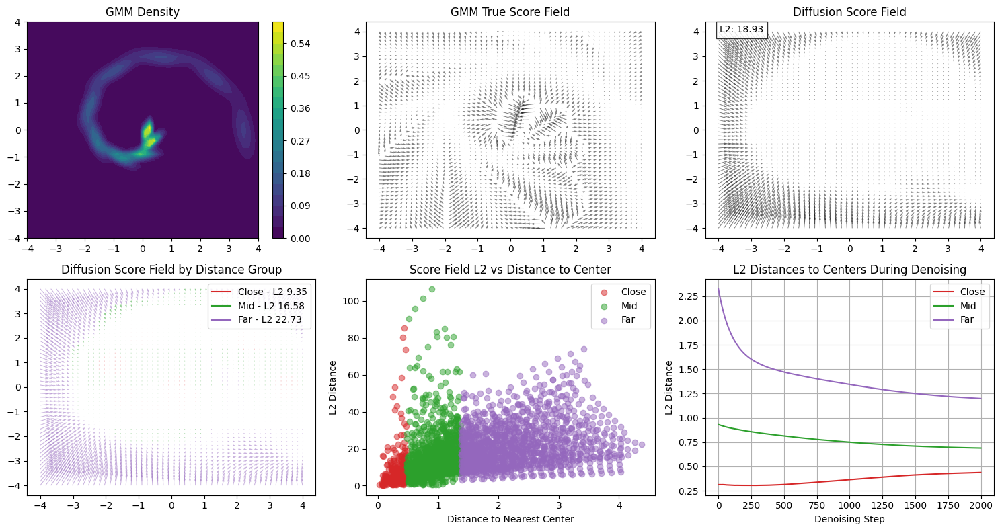

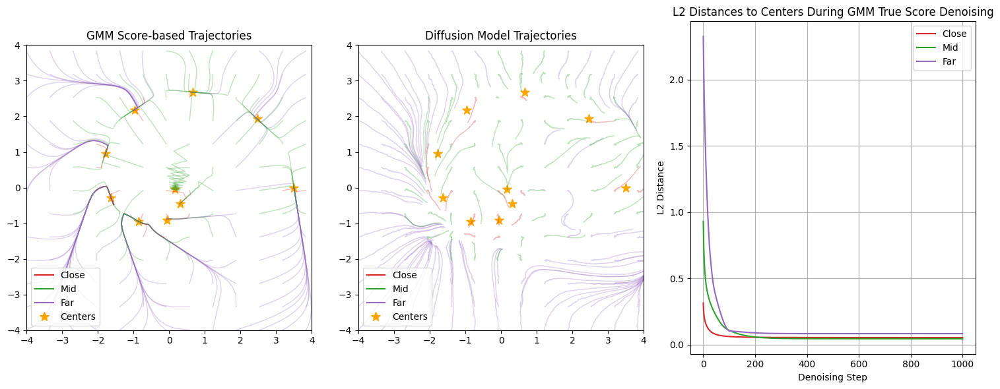

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d_spiral_2']['mus']
covs = gmm_params['2d_spiral_2']['covs']
weights = gmm_params['2d_spiral_2']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/uniform/noise_scale_01_1PointUNet_denoising/gmm_new_2d/spiral_2/100000/denoiser_epoch_10.pt'
model_noise_type = 'uniform'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.8537
Iteration 100: sigma=0.4048
Iteration 200: sigma=0.2178
Iteration 300: sigma=0.1271
Iteration 400: sigma=0.0878
Iteration 500: sigma=0.0659
Iteration 600: sigma=0.0545
Iteration 700: sigma=0.0459
Iteration 800: sigma=0.0397
Iteration 900: sigma=0.0353
Iteration 1000: sigma=0.0319
Iteration 1100: sigma=0.0288
Iteration 1200: sigma=0.0259
Iteration 1300: sigma=0.0236
Iteration 1400: sigma=0.0217
Iteration 1500: sigma=0.0202
Iteration 1600: sigma=0.0190
Iteration 1700: sigma=0.0180
Iteration 1800: sigma=0.0172
Iteration 1900: sigma=0.0166
Iteration 2000: sigma=0.0161
Final sigma: 0.0161, total iterations: 2000
Avg time per iteration: 0.1103 s
Iteration 1: sigma=0.8537
Iteration 100: sigma=0.4041
Iteration 200: sigma=0.2179
Iteration 300: sigma=0.1281
Iteration 400: sigma=0.0871
Iteration 500: sigma=0.0654
Iteration 600: sigma=0.0545
Iteration 700: sigma=0.0458
Iteration 800: sigma=0.0396
Iteration 900: sigma=0.0351
Iteration 1000: sigma=0.0319
Iteration 1100: sig

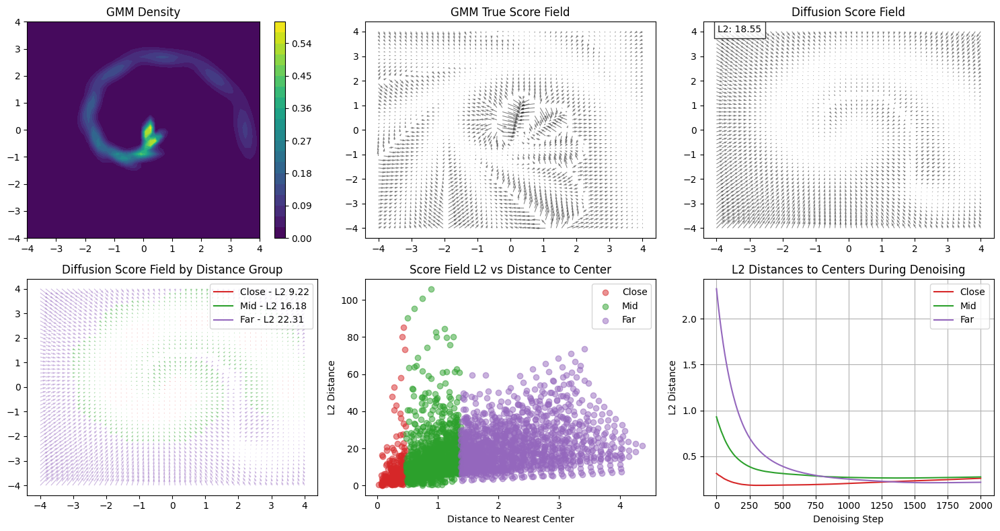

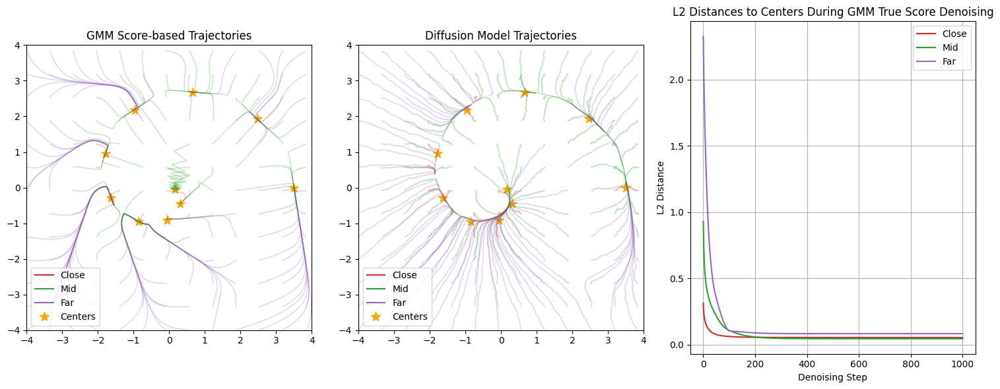

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d_spiral_2']['mus']
covs = gmm_params['2d_spiral_2']['covs']
weights = gmm_params['2d_spiral_2']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/uniform/noise_scale_1_10PointUNet_denoising/gmm_new_2d/spiral_2/100000/denoiser_epoch_10.pt'
model_noise_type = 'uniform'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d']['mus']
covs = gmm_params['2d']['covs']
weights = gmm_params['2d']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/laplace/noise_scale_0001_001PointUNet_denoising/gmm_new_2d/100000/denoiser_epoch_10.pt'
model_noise_type = 'laplace'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.4039
Iteration 100: sigma=0.1664
Iteration 200: sigma=0.0900
Iteration 300: sigma=0.0628
Iteration 400: sigma=0.0500
Iteration 500: sigma=0.0425
Iteration 600: sigma=0.0374
Iteration 700: sigma=0.0336
Iteration 800: sigma=0.0309
Iteration 900: sigma=0.0288
Iteration 1000: sigma=0.0270
Iteration 1100: sigma=0.0257
Iteration 1200: sigma=0.0247
Iteration 1300: sigma=0.0240
Iteration 1400: sigma=0.0233


In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d']['mus']
covs = gmm_params['2d']['covs']
weights = gmm_params['2d']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/laplace/noise_scale_001_01PointUNet_denoising/gmm_new_2d/100000/denoiser_epoch_10.pt'
model_noise_type = 'laplace'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d']['mus']
covs = gmm_params['2d']['covs']
weights = gmm_params['2d']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/laplace/noise_scale_01_1PointUNet_denoising/gmm_new_2d/100000/denoiser_epoch_10.pt'
model_noise_type = 'laplace'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=1.5079
Iteration 100: sigma=0.6178
Iteration 200: sigma=0.3086
Iteration 300: sigma=0.1901
Iteration 400: sigma=0.1321
Iteration 500: sigma=0.0961
Iteration 600: sigma=0.0717
Iteration 700: sigma=0.0542
Iteration 800: sigma=0.0416
Iteration 900: sigma=0.0318
Iteration 1000: sigma=0.0243
Iteration 1100: sigma=0.0185
Iteration 1200: sigma=0.0141
Iteration 1300: sigma=0.0107
Final sigma: 0.0100, total iterations: 1325
Avg time per iteration: 0.1118 s
Iteration 1: sigma=1.5079
Iteration 100: sigma=0.6159
Iteration 200: sigma=0.3079
Iteration 300: sigma=0.1903
Iteration 400: sigma=0.1344
Iteration 500: sigma=0.0979
Iteration 600: sigma=0.0726
Iteration 700: sigma=0.0549
Iteration 800: sigma=0.0420
Iteration 900: sigma=0.0321
Iteration 1000: sigma=0.0245
Iteration 1100: sigma=0.0186
Iteration 1200: sigma=0.0142
Iteration 1300: sigma=0.0108
Final sigma: 0.0100, total iterations: 1328
Avg time per iteration: 0.1306 s


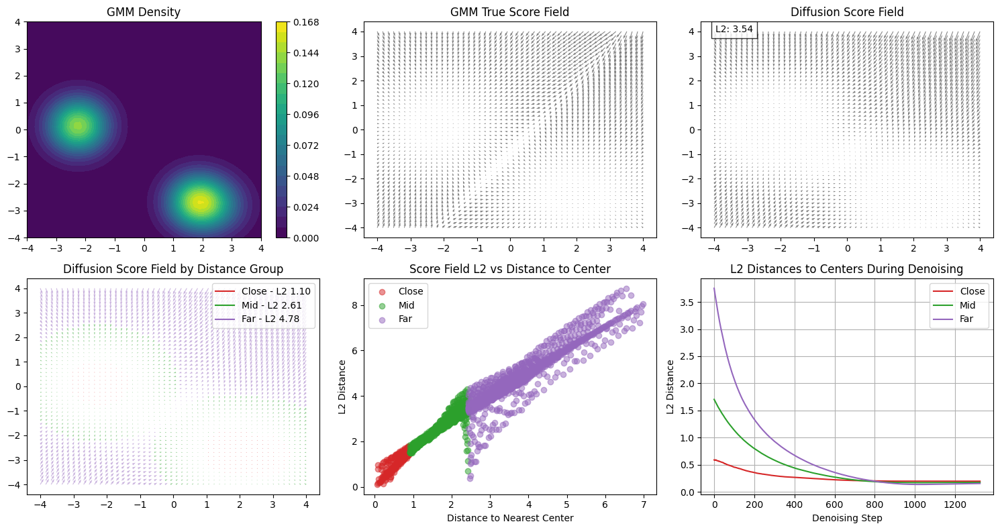

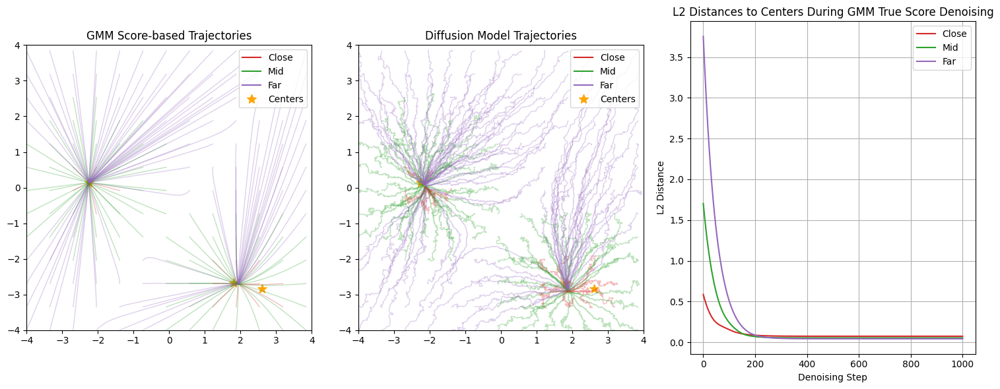

In [48]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d']['mus']
covs = gmm_params['2d']['covs']
weights = gmm_params['2d']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/laplace/noise_scale_1_10PointUNet_denoising/gmm_new_2d/100000/denoiser_epoch_10.pt'
model_noise_type = 'laplace'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=1.2378
Iteration 100: sigma=0.5928
Iteration 200: sigma=0.3240
Iteration 300: sigma=0.2011
Iteration 400: sigma=0.1373
Iteration 500: sigma=0.0980
Iteration 600: sigma=0.0718
Iteration 700: sigma=0.0531
Iteration 800: sigma=0.0394
Iteration 900: sigma=0.0293
Iteration 1000: sigma=0.0217
Iteration 1100: sigma=0.0159
Iteration 1200: sigma=0.0117
Final sigma: 0.0100, total iterations: 1253
Avg time per iteration: 0.1087 s
Iteration 1: sigma=1.2378
Iteration 100: sigma=0.5920
Iteration 200: sigma=0.3223
Iteration 300: sigma=0.2012
Iteration 400: sigma=0.1377
Iteration 500: sigma=0.0979
Iteration 600: sigma=0.0718
Iteration 700: sigma=0.0531
Iteration 800: sigma=0.0393
Iteration 900: sigma=0.0293
Iteration 1000: sigma=0.0217
Iteration 1100: sigma=0.0159
Iteration 1200: sigma=0.0117
Final sigma: 0.0100, total iterations: 1253
Avg time per iteration: 0.1106 s


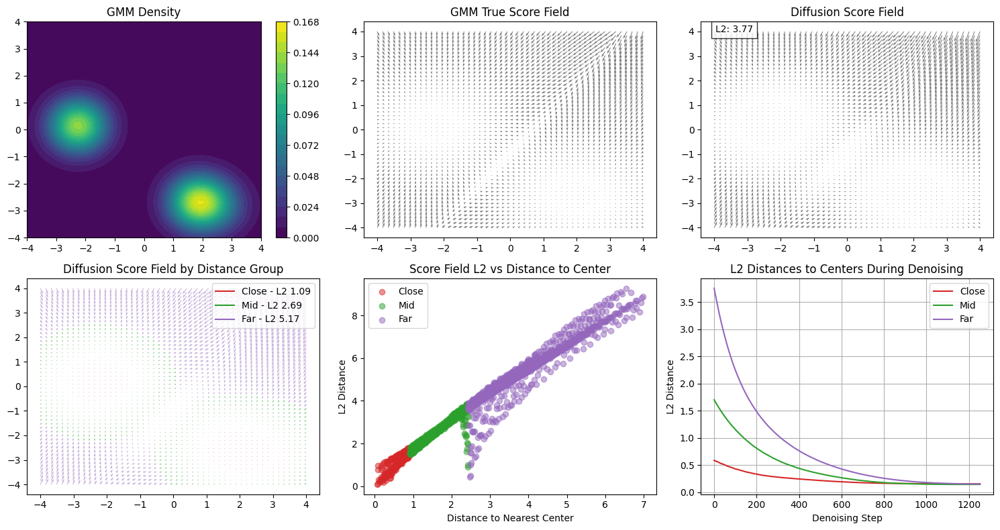

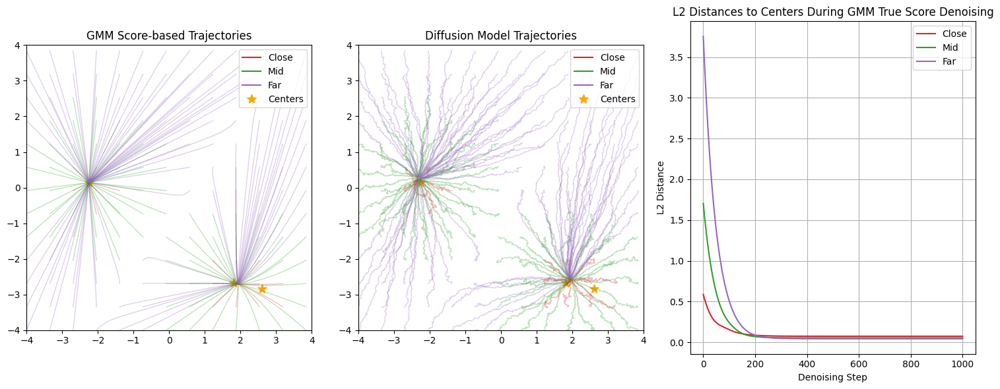

In [50]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d']['mus']
covs = gmm_params['2d']['covs']
weights = gmm_params['2d']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/gaussian/noise_scale_1_10PointUNet_denoising/gmm_new_2d/100000/denoiser_epoch_10.pt'
model_noise_type = 'gaussian'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.6786
Iteration 100: sigma=0.3909
Iteration 200: sigma=0.2764
Iteration 300: sigma=0.2139
Iteration 400: sigma=0.1761
Iteration 500: sigma=0.1493
Iteration 600: sigma=0.1250
Iteration 700: sigma=0.1043
Iteration 800: sigma=0.0859
Iteration 900: sigma=0.0700
Iteration 1000: sigma=0.0568
Iteration 1100: sigma=0.0468
Iteration 1200: sigma=0.0393
Iteration 1300: sigma=0.0334
Iteration 1400: sigma=0.0287
Iteration 1500: sigma=0.0246
Iteration 1600: sigma=0.0210
Iteration 1700: sigma=0.0181
Iteration 1800: sigma=0.0157
Iteration 1900: sigma=0.0135
Iteration 2000: sigma=0.0114
Final sigma: 0.0114, total iterations: 2000
Avg time per iteration: 0.1096 s
Iteration 1: sigma=0.6786
Iteration 100: sigma=0.3908
Iteration 200: sigma=0.2759
Iteration 300: sigma=0.2141
Iteration 400: sigma=0.1764
Iteration 500: sigma=0.1491
Iteration 600: sigma=0.1246
Iteration 700: sigma=0.1039
Iteration 800: sigma=0.0856
Iteration 900: sigma=0.0698
Iteration 1000: sigma=0.0569
Iteration 1100: sig

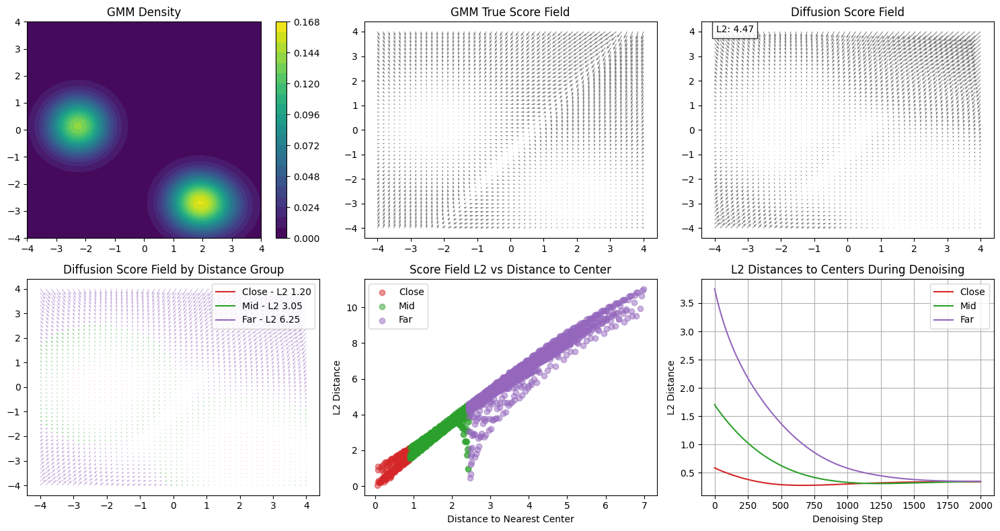

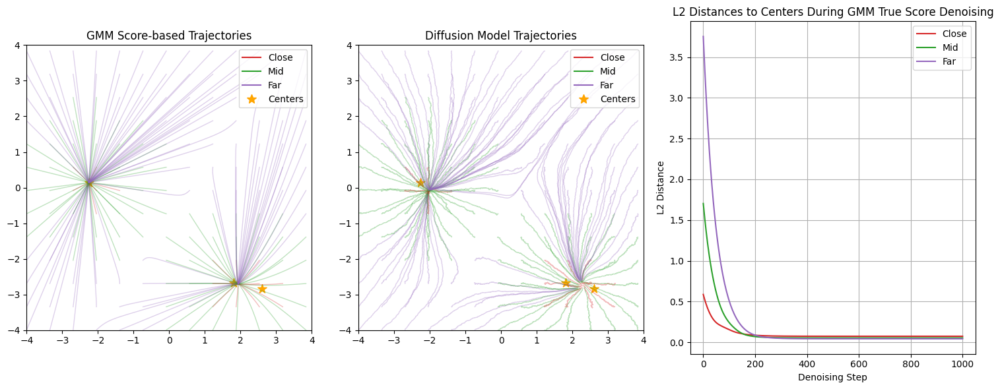

In [51]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d']['mus']
covs = gmm_params['2d']['covs']
weights = gmm_params['2d']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/uniform/noise_scale_1_10PointUNet_denoising/gmm_new_2d/100000/denoiser_epoch_10.pt'
model_noise_type = 'uniform'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=1.4911
Iteration 100: sigma=0.6371
Iteration 200: sigma=0.2977
Iteration 300: sigma=0.1494
Iteration 400: sigma=0.0902
Iteration 500: sigma=0.0612
Iteration 600: sigma=0.0451
Iteration 700: sigma=0.0340
Iteration 800: sigma=0.0260
Iteration 900: sigma=0.0200
Iteration 1000: sigma=0.0157
Iteration 1100: sigma=0.0126
Iteration 1200: sigma=0.0102
Final sigma: 0.0100, total iterations: 1210
Avg time per iteration: 0.1391 s
Iteration 1: sigma=1.4911
Iteration 100: sigma=0.6352
Iteration 200: sigma=0.2985
Iteration 300: sigma=0.1511
Iteration 400: sigma=0.0889
Iteration 500: sigma=0.0608
Iteration 600: sigma=0.0449
Iteration 700: sigma=0.0340
Iteration 800: sigma=0.0260
Iteration 900: sigma=0.0200
Iteration 1000: sigma=0.0157
Iteration 1100: sigma=0.0125
Iteration 1200: sigma=0.0102
Final sigma: 0.0100, total iterations: 1210
Avg time per iteration: 0.1149 s


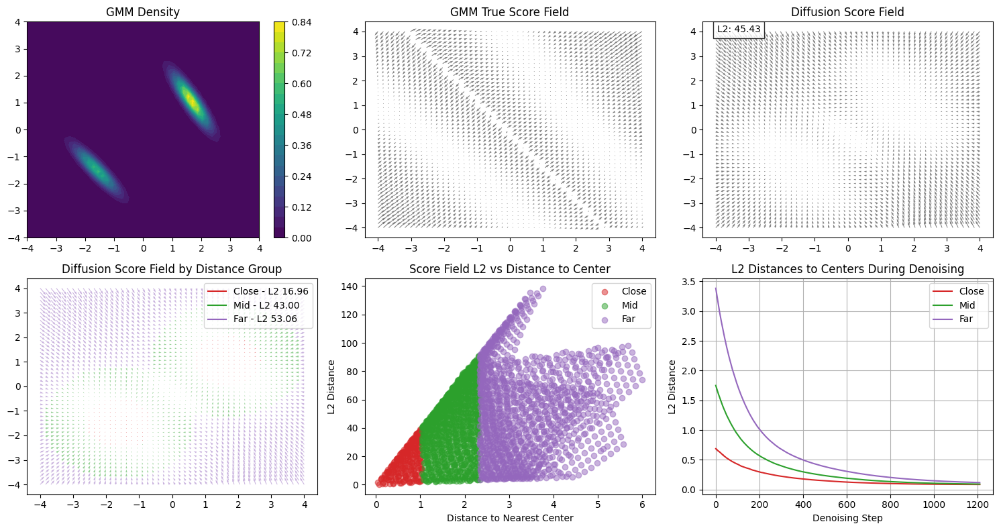

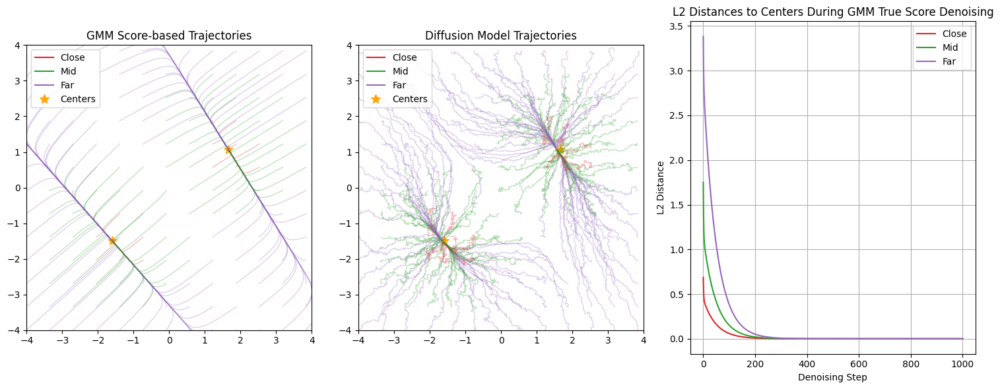

In [52]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d_sharp']['mus']
covs = gmm_params['2d_sharp']['covs']
weights = gmm_params['2d_sharp']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/laplace/noise_scale_1_10PointUNet_denoising/gmm_new_2d/very_sharp/100000/denoiser_epoch_10.pt'
model_noise_type = 'laplace'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=1.2983
Iteration 100: sigma=0.5854
Iteration 200: sigma=0.2689
Iteration 300: sigma=0.1495
Iteration 400: sigma=0.0985
Iteration 500: sigma=0.0710
Iteration 600: sigma=0.0541
Iteration 700: sigma=0.0423
Iteration 800: sigma=0.0334
Iteration 900: sigma=0.0266
Iteration 1000: sigma=0.0215
Iteration 1100: sigma=0.0174
Iteration 1200: sigma=0.0142
Iteration 1300: sigma=0.0117
Final sigma: 0.0100, total iterations: 1377
Avg time per iteration: 0.1123 s
Iteration 1: sigma=1.2983
Iteration 100: sigma=0.5861
Iteration 200: sigma=0.2700
Iteration 300: sigma=0.1497
Iteration 400: sigma=0.0986
Iteration 500: sigma=0.0711
Iteration 600: sigma=0.0542
Iteration 700: sigma=0.0423
Iteration 800: sigma=0.0335
Iteration 900: sigma=0.0267
Iteration 1000: sigma=0.0216
Iteration 1100: sigma=0.0175
Iteration 1200: sigma=0.0143
Iteration 1300: sigma=0.0117
Final sigma: 0.0100, total iterations: 1379
Avg time per iteration: 0.1117 s


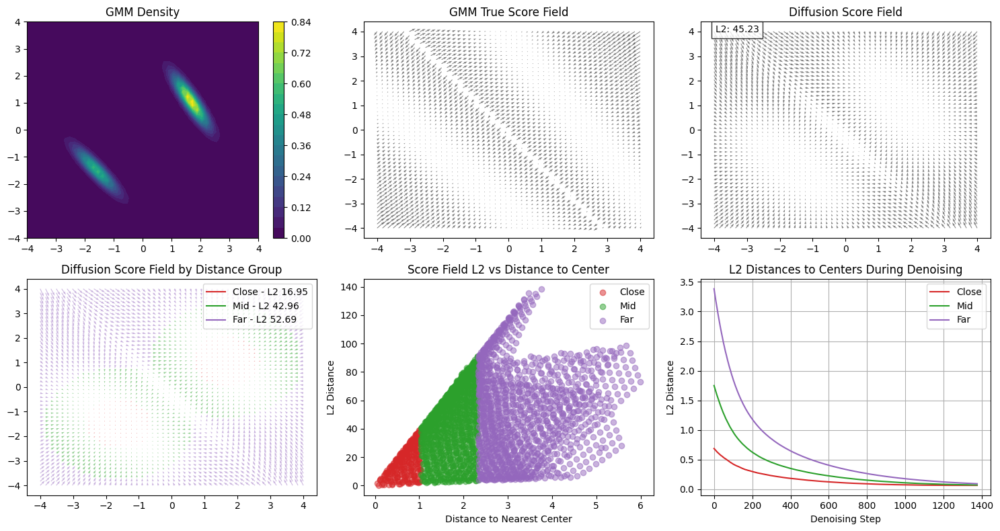

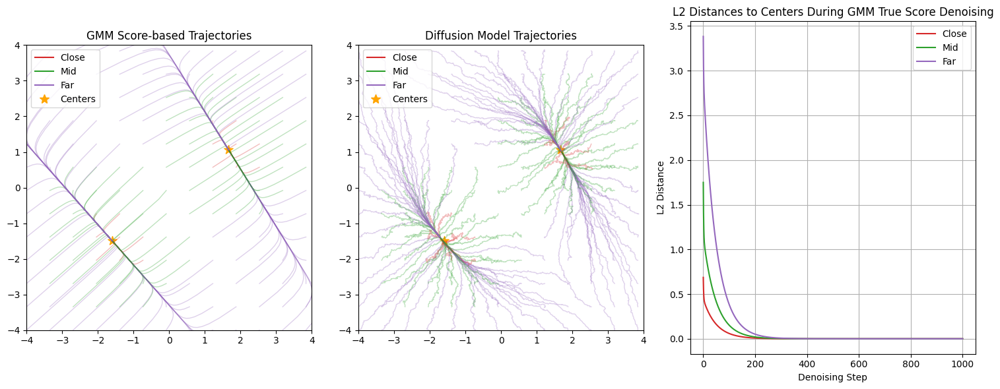

In [53]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d_sharp']['mus']
covs = gmm_params['2d_sharp']['covs']
weights = gmm_params['2d_sharp']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/gaussian/noise_scale_1_10PointUNet_denoising/gmm_new_2d/very_sharp/100000/denoiser_epoch_10.pt'
model_noise_type = 'gaussian'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.8514
Iteration 100: sigma=0.4321
Iteration 200: sigma=0.2797
Iteration 300: sigma=0.2072
Iteration 400: sigma=0.1591
Iteration 500: sigma=0.1237
Iteration 600: sigma=0.0962
Iteration 700: sigma=0.0770
Iteration 800: sigma=0.0633
Iteration 900: sigma=0.0536
Iteration 1000: sigma=0.0454
Iteration 1100: sigma=0.0385
Iteration 1200: sigma=0.0332
Iteration 1300: sigma=0.0290
Iteration 1400: sigma=0.0259
Iteration 1500: sigma=0.0234
Iteration 1600: sigma=0.0209
Iteration 1700: sigma=0.0183
Iteration 1800: sigma=0.0160
Iteration 1900: sigma=0.0141
Iteration 2000: sigma=0.0125
Final sigma: 0.0125, total iterations: 2000
Avg time per iteration: 0.1102 s
Iteration 1: sigma=0.8514
Iteration 100: sigma=0.4318
Iteration 200: sigma=0.2796
Iteration 300: sigma=0.2072
Iteration 400: sigma=0.1577
Iteration 500: sigma=0.1233
Iteration 600: sigma=0.0991
Iteration 700: sigma=0.0805
Iteration 800: sigma=0.0653
Iteration 900: sigma=0.0548
Iteration 1000: sigma=0.0462
Iteration 1100: sig

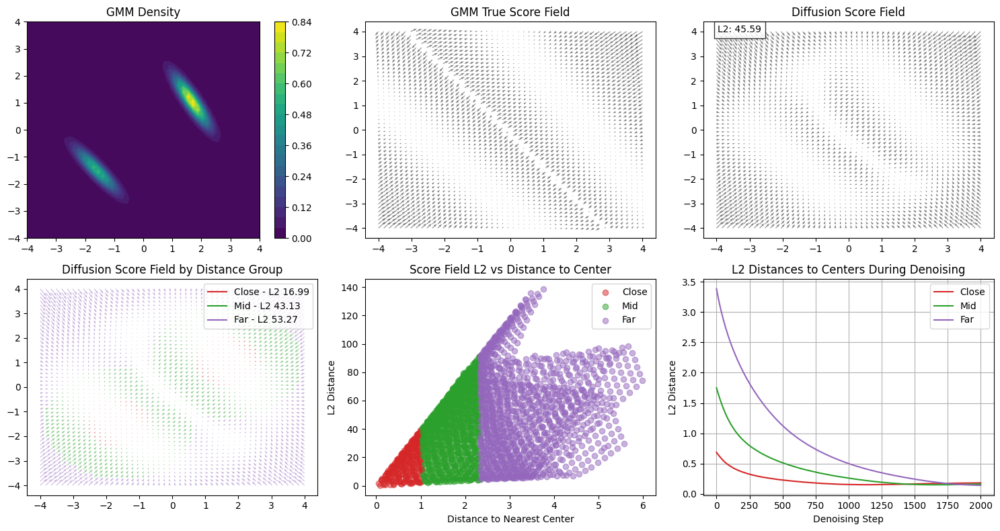

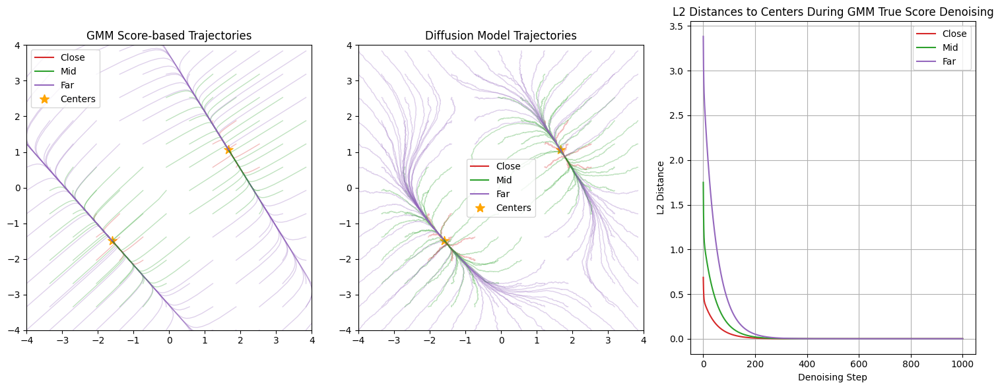

In [54]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d_sharp']['mus']
covs = gmm_params['2d_sharp']['covs']
weights = gmm_params['2d_sharp']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/uniform/noise_scale_1_10PointUNet_denoising/gmm_new_2d/very_sharp/100000/denoiser_epoch_10.pt'
model_noise_type = 'uniform'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=1.2391
Iteration 100: sigma=0.4673
Iteration 200: sigma=0.2064
Iteration 300: sigma=0.1222
Iteration 400: sigma=0.0805
Iteration 500: sigma=0.0622
Iteration 600: sigma=0.0558
Iteration 700: sigma=0.0526
Iteration 800: sigma=0.0504
Iteration 900: sigma=0.0484
Iteration 1000: sigma=0.0461
Iteration 1100: sigma=0.0438
Iteration 1200: sigma=0.0416
Iteration 1300: sigma=0.0395
Iteration 1400: sigma=0.0376
Iteration 1500: sigma=0.0357
Iteration 1600: sigma=0.0343
Iteration 1700: sigma=0.0331
Iteration 1800: sigma=0.0318
Iteration 1900: sigma=0.0310
Iteration 2000: sigma=0.0303
Final sigma: 0.0303, total iterations: 2000
Avg time per iteration: 0.1102 s
Iteration 1: sigma=1.2391
Iteration 100: sigma=0.4690
Iteration 200: sigma=0.2063
Iteration 300: sigma=0.1142
Iteration 400: sigma=0.0810
Iteration 500: sigma=0.0671
Iteration 600: sigma=0.0568
Iteration 700: sigma=0.0523
Iteration 800: sigma=0.0495
Iteration 900: sigma=0.0474
Iteration 1000: sigma=0.0453
Iteration 1100: sig

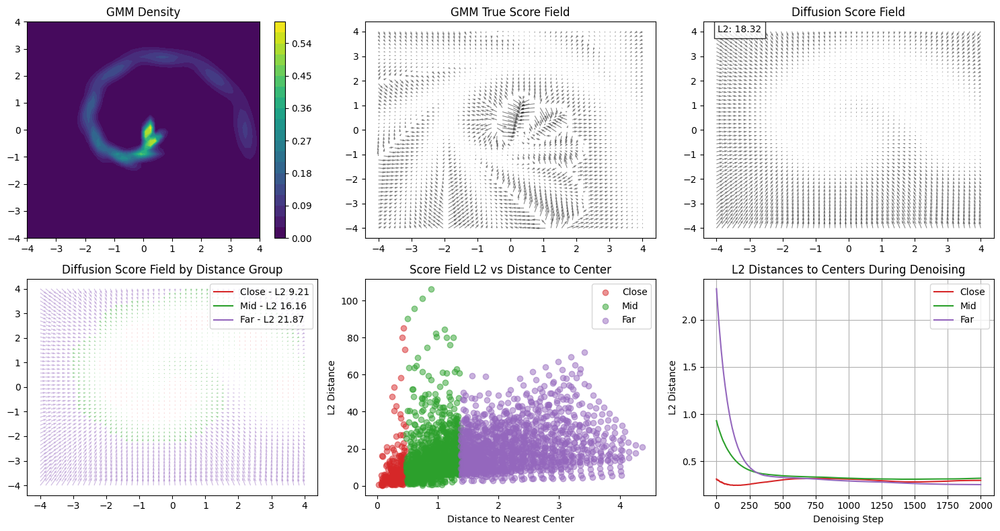

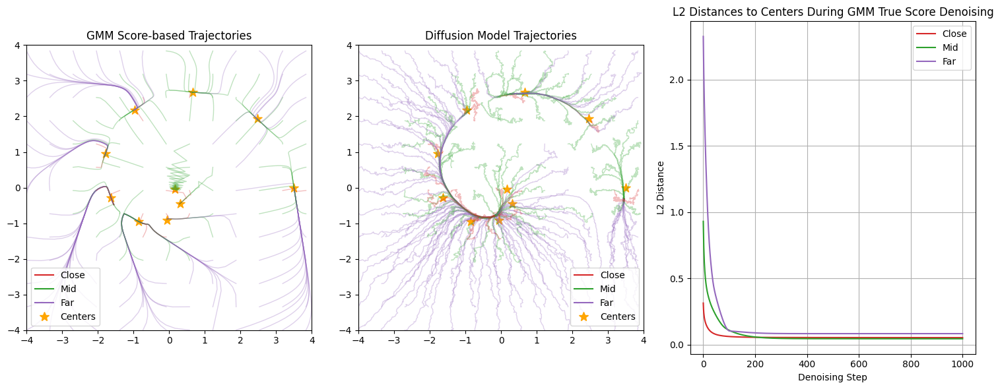

In [55]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d_spiral_2']['mus']
covs = gmm_params['2d_spiral_2']['covs']
weights = gmm_params['2d_spiral_2']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/laplace/noise_scale_1_10PointUNet_denoising/gmm_new_2d/spiral_2/100000/denoiser_epoch_10.pt'
model_noise_type = 'laplace'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=1.0891
Iteration 100: sigma=0.4567
Iteration 200: sigma=0.2070
Iteration 300: sigma=0.1121
Iteration 400: sigma=0.0809
Iteration 500: sigma=0.0701
Iteration 600: sigma=0.0647
Iteration 700: sigma=0.0613
Iteration 800: sigma=0.0586
Iteration 900: sigma=0.0562
Iteration 1000: sigma=0.0539
Iteration 1100: sigma=0.0515
Iteration 1200: sigma=0.0491
Iteration 1300: sigma=0.0467
Iteration 1400: sigma=0.0444
Iteration 1500: sigma=0.0424
Iteration 1600: sigma=0.0405
Iteration 1700: sigma=0.0387
Iteration 1800: sigma=0.0370
Iteration 1900: sigma=0.0352
Iteration 2000: sigma=0.0334
Final sigma: 0.0334, total iterations: 2000
Avg time per iteration: 0.1079 s
Iteration 1: sigma=1.0891
Iteration 100: sigma=0.4609
Iteration 200: sigma=0.2058
Iteration 300: sigma=0.1125
Iteration 400: sigma=0.0812
Iteration 500: sigma=0.0702
Iteration 600: sigma=0.0648
Iteration 700: sigma=0.0612
Iteration 800: sigma=0.0584
Iteration 900: sigma=0.0561
Iteration 1000: sigma=0.0537
Iteration 1100: sig

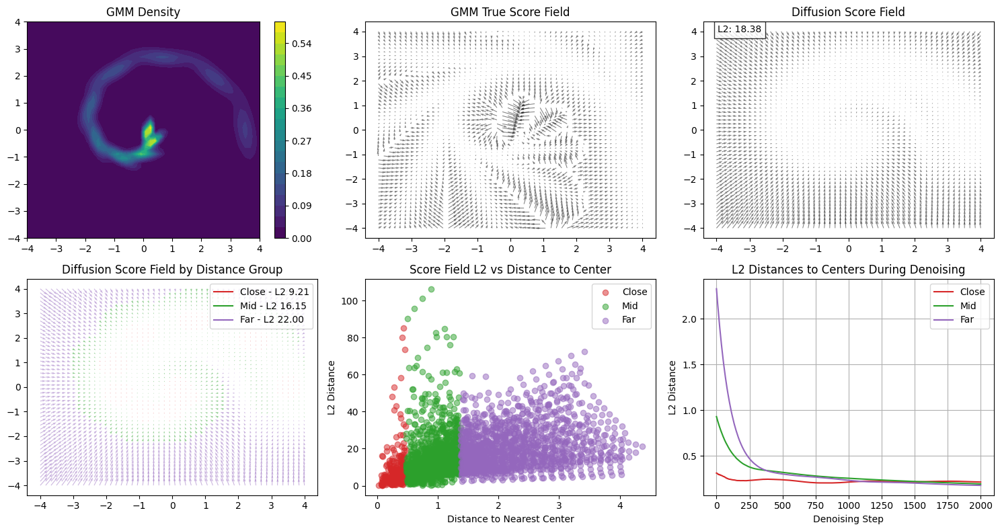

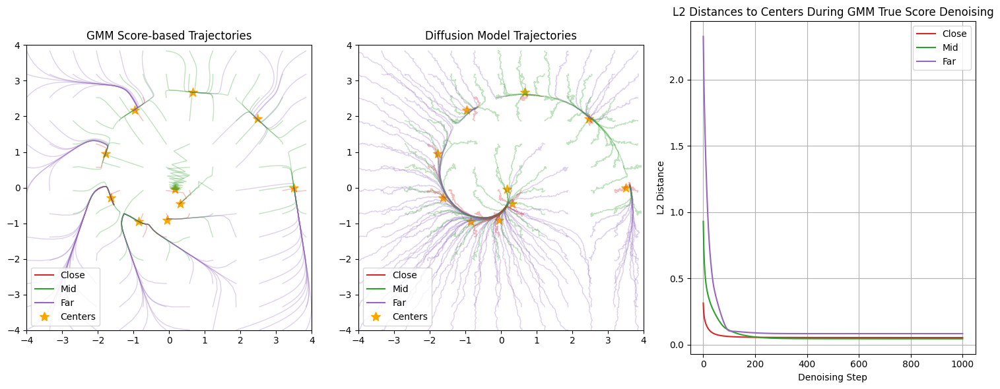

In [56]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d_spiral_2']['mus']
covs = gmm_params['2d_spiral_2']['covs']
weights = gmm_params['2d_spiral_2']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/gaussian/noise_scale_1_10PointUNet_denoising/gmm_new_2d/spiral_2/100000/denoiser_epoch_10.pt'
model_noise_type = 'gaussian'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

<ipython-input-9-70783e368e1d>:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.8537
Iteration 100: sigma=0.4044
Iteration 200: sigma=0.2177
Iteration 300: sigma=0.1281
Iteration 400: sigma=0.0857
Iteration 500: sigma=0.0664
Iteration 600: sigma=0.0546
Iteration 700: sigma=0.0458
Iteration 800: sigma=0.0394
Iteration 900: sigma=0.0350
Iteration 1000: sigma=0.0317
Iteration 1100: sigma=0.0287
Iteration 1200: sigma=0.0260
Iteration 1300: sigma=0.0238
Iteration 1400: sigma=0.0220
Iteration 1500: sigma=0.0205
Iteration 1600: sigma=0.0193
Iteration 1700: sigma=0.0183
Iteration 1800: sigma=0.0174
Iteration 1900: sigma=0.0167
Iteration 2000: sigma=0.0162
Final sigma: 0.0162, total iterations: 2000
Avg time per iteration: 0.1076 s
Iteration 1: sigma=0.8537
Iteration 100: sigma=0.4050
Iteration 200: sigma=0.2191
Iteration 300: sigma=0.1273
Iteration 400: sigma=0.0844
Iteration 500: sigma=0.0653
Iteration 600: sigma=0.0546
Iteration 700: sigma=0.0461
Iteration 800: sigma=0.0398
Iteration 900: sigma=0.0353
Iteration 1000: sigma=0.0319
Iteration 1100: sig

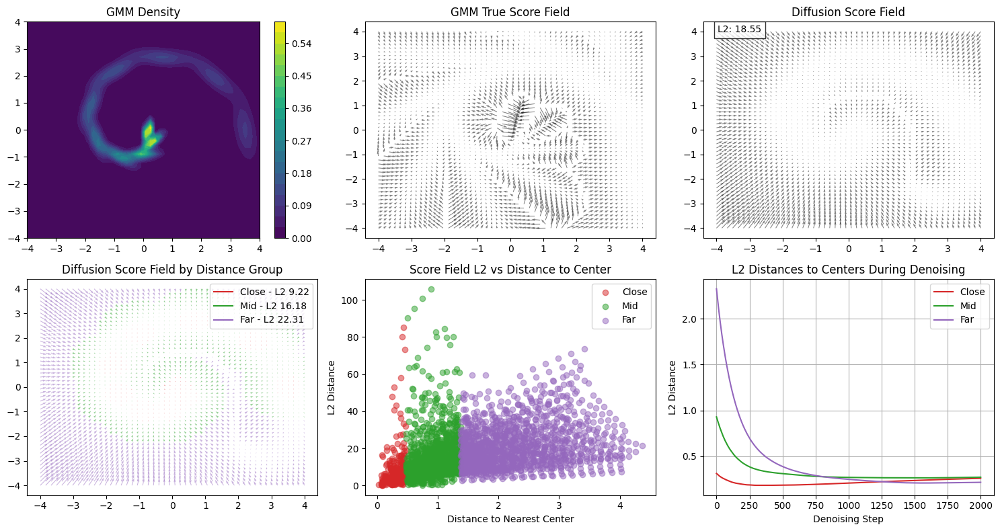

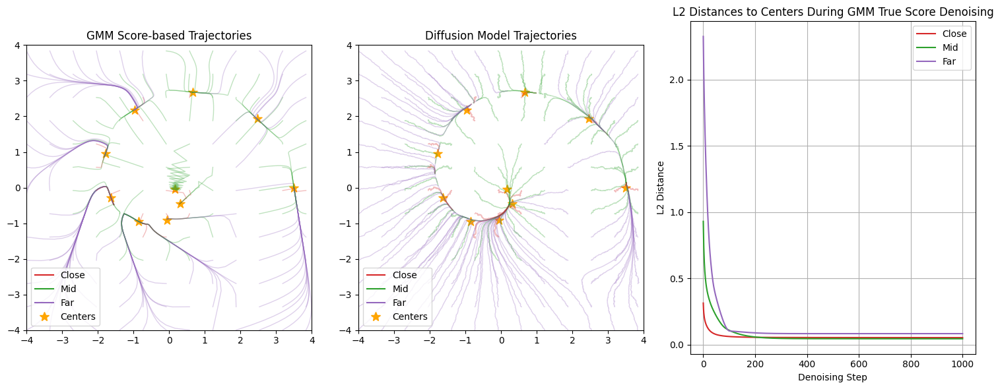

In [57]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['2d_spiral_2']['mus']
covs = gmm_params['2d_spiral_2']['covs']
weights = gmm_params['2d_spiral_2']['weights']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/uniform/noise_scale_1_10PointUNet_denoising/gmm_new_2d/spiral_2/100000/denoiser_epoch_10.pt'
model_noise_type = 'uniform'

score_fig, traj_fig  = analyze_model( #, denoising_fig
    model_path=model_path,
    gmm_params=(mus, covs, weights),
    device='cpu',
    noise_type=model_noise_type
)

In [60]:
def plot_high_dim_analysis(model, gmm, device, sample_size=1000, plot_size=50, model_noise_type='gaussian'):

    model.eval()
    dim = gmm.dim

    def langevin_sample(gmm, dim, n_samples=1000, n_steps=400, step_size=0.002, sigma=1.0):
        means = gmm.mus
        std = np.std(means, axis=0)
        mean = np.mean(means, axis=0)

    #init within GMM range
        x = mean + np.random.randn(n_samples, dim) * std

        samples = []
        for t in range(n_steps):
            x_tensor = torch.tensor(x, device=device, dtype=torch.float32)
            score = torch.tensor(gmm.score(x), device=device, dtype=torch.float32)

            noise = np.random.randn(*x.shape) * np.sqrt(2 * step_size)
            x = x + step_size * score.cpu().numpy() + sigma * noise

            if t % 100 == 0:
                samples.append(x.copy())

        return np.concatenate(samples, axis=0)

    points = langevin_sample(gmm, dim, sample_size)
    gmm_samples, _, _ = gmm.sample(sample_size)

    points_tensor = torch.tensor(gmm_samples, device=device, dtype=torch.float32)

    true_scores = torch.tensor(gmm.score(gmm_samples), device=device)
    close_mask, medium_mask, far_mask = categorize_samples_by_distance(points_tensor, gmm.mus)

    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    # 1. Density Analysis via Distance Distribution
    ax = axes[0]
    langevin_distances = torch.stack([
        torch.norm(points_tensor - torch.tensor(mu, device=device), dim=1)
        for mu in gmm.mus
    ]).min(dim=0).values.cpu()

    gmm_points_tensor = torch.tensor(gmm_samples, device=device)
    gmm_distances = torch.stack([
        torch.norm(gmm_points_tensor - torch.tensor(mu, device=device), dim=1)
        for mu in gmm.mus
    ]).min(dim=0).values.cpu()

    #ax.hist(langevin_distances, bins=50, density=True, alpha=0.6, label='Langevin Samples', color='tab:blue')
    ax.hist(gmm_distances, bins=50, density=True, alpha=0.6, label='GMM Samples', color='tab:orange')
    ax.set_title(f'{dim}D Distance Distribution')
    ax.set_xlabel('Distance to Nearest Center')
    ax.set_ylabel('Density')
    ax.legend()

    # 2. L2 Analysis
    ax = axes[1]
    with torch.no_grad():
        denoised_points = model(points_tensor)
        derived_scores = -(points_tensor - denoised_points)

    distances = torch.stack([
        torch.norm(points_tensor - torch.tensor(mu, device=device), dim=1)
        for mu in gmm.mus
    ]).min(dim=0).values.cpu()

    true_norms = torch.norm(true_scores, dim=1).cpu()
    derived_norms = torch.norm(derived_scores, dim=1).cpu()
    l2_diffs = torch.norm(derived_scores - true_scores, dim=1)

    colors = np.empty(len(gmm_samples), dtype=object)
    colors[close_mask.cpu()] = 'tab:red'
    colors[medium_mask.cpu()] = 'tab:green'
    colors[far_mask.cpu()] = 'tab:purple'

    for mask, color, label in zip([close_mask, medium_mask, far_mask],
                                ['tab:red', 'tab:green', 'tab:purple'],
                                ['Close', 'Mid', 'Far']):
        mask_cpu = mask.cpu()
        ax.scatter(distances[mask_cpu], l2_diffs[mask_cpu],
                   c=color, alpha=0.5, label=f'{label}')

    ax.set_title('Score Field L2 vs Distance to Center')
    ax.set_xlabel('Distance to Nearest Center')
    ax.set_ylabel('L2')
    ax.legend()

    # 3. Denoising Process Analysis
    ax = axes[2]
    _, all_points, _ = univ_inv_solve_gmm(
        model, points_tensor, device,
        sig_0=1.0, sig_L=0.005,
        h0=0.01, beta=0.01,
        freq=100, max_T=1000, noise_type=model_noise_type
    )

    trajectories = torch.stack(all_points)
    steps = range(len(trajectories))

    for mask, label, color in zip([close_mask, medium_mask, far_mask],
                                ['Close', 'Medium', 'Far'],
                                ['tab:red', 'tab:green', 'tab:purple']):
        masked_trajectories = trajectories[:, mask]

        avg_distances = []
        for step_points in masked_trajectories:
            min_dists = torch.stack([
                torch.norm(step_points - torch.tensor(mu, device=device), dim=1)
                for mu in gmm.mus
            ]).min(dim=0).values
            avg_distances.append(min_dists.mean().item())

        ax.plot(steps, avg_distances, label=label, color=color)

    ax.set_title('L2 Distances During Denoising')
    ax.set_xlabel('Denoising Step')
    ax.set_ylabel('Avg Distance to Nearest Center')
    ax.legend()
    ax.grid(True)

    plt.tight_layout()
    return fig

In [34]:
def analyze_high_d(model_path, gmm_params, device, n_samples=1000, noise_levels=[0.01, 0.1, 0.5, 1.0], model_noise_type='gaussian'):
    from sklearn.decomposition import PCA
    from sklearn.neighbors import NearestNeighbors

    mus, covs, weights, dim = gmm_params
    gmm = GaussianMixture(mus, covs, weights)

    #load model
    class Args:
        def __init__(self):
            self.num_blocks = 3
            self.num_kernels = 64
            self.num_enc_conv = 2
            self.num_mid_conv = 2
            self.num_dec_conv = 2
            self.bias = True
            self.input_dim = dim

    args = Args()
    model = PointUNet(args).to(device)
    model.load_state_dict(torch.load(model_path, map_location=device))

    score_fig = plot_high_dim_analysis(model, gmm, device, model_noise_type=model_noise_type)

    return score_fig

<ipython-input-16-710692f76e5a>:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))
<ipython-input-10-f822e7

Iteration 1: sigma=0.2341
Iteration 100: sigma=0.1691
Iteration 200: sigma=0.1347
Iteration 300: sigma=0.1106
Iteration 400: sigma=0.0924
Iteration 500: sigma=0.0778
Iteration 600: sigma=0.0657
Iteration 700: sigma=0.0557
Iteration 800: sigma=0.0475
Iteration 900: sigma=0.0405
Iteration 1000: sigma=0.0347
Final sigma: 0.0347, total iterations: 1000
Avg time per iteration: 0.2033 s


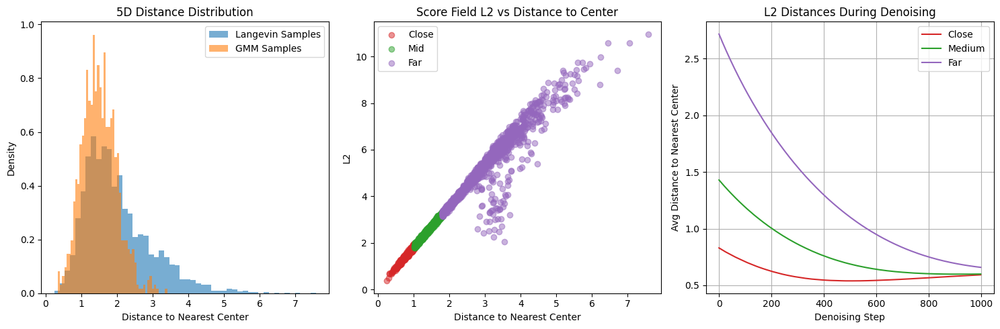

In [17]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['5d']['mus']
covs = gmm_params['5d']['covs']
weights = gmm_params['5d']['weights']
dim = gmm_params['5d']['n_features']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_noise_type = 'uniform'

model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/uniform/noise_scale_1_10PointUNet_denoising/gmm_new_5d/100000/denoiser_epoch_10.pt'


fig  = analyze_high_d(
    model_path=model_path,
    gmm_params=(mus, covs, weights, dim),
    device='cpu',
    model_noise_type=model_noise_type
)

<ipython-input-16-710692f76e5a>:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.5297
Iteration 100: sigma=0.2554
Iteration 200: sigma=0.1443
Iteration 300: sigma=0.0983
Iteration 400: sigma=0.0750
Iteration 500: sigma=0.0603
Iteration 600: sigma=0.0499
Iteration 700: sigma=0.0415
Iteration 800: sigma=0.0342
Iteration 900: sigma=0.0277
Iteration 1000: sigma=0.0222
Final sigma: 0.0222, total iterations: 1000
Avg time per iteration: 0.1732 s


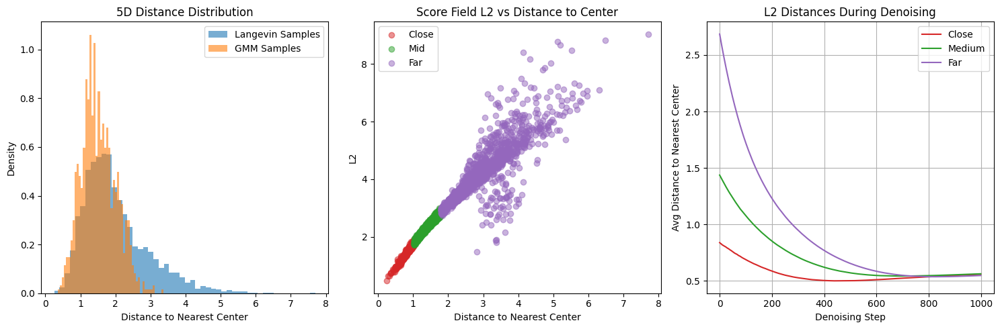

In [18]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['5d']['mus']
covs = gmm_params['5d']['covs']
weights = gmm_params['5d']['weights']
dim = gmm_params['5d']['n_features']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_noise_type = 'laplace'

model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/laplace/noise_scale_1_10PointUNet_denoising/gmm_new_5d/100000/denoiser_epoch_10.pt'


fig  = analyze_high_d(
    model_path=model_path,
    gmm_params=(mus, covs, weights, dim),
    device='cpu',
    model_noise_type=model_noise_type
)

<ipython-input-16-710692f76e5a>:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.4210
Iteration 100: sigma=0.2333
Iteration 200: sigma=0.1384
Iteration 300: sigma=0.0943
Iteration 400: sigma=0.0718
Iteration 500: sigma=0.0585
Iteration 600: sigma=0.0492
Iteration 700: sigma=0.0422
Iteration 800: sigma=0.0365
Iteration 900: sigma=0.0317
Iteration 1000: sigma=0.0275
Final sigma: 0.0275, total iterations: 1000
Avg time per iteration: 0.1802 s


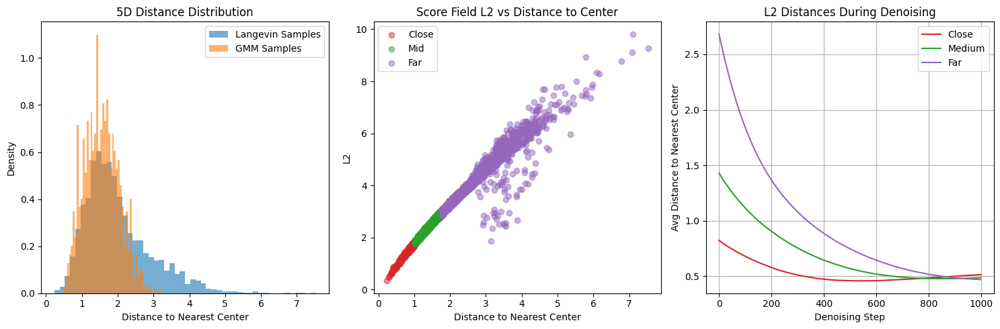

In [19]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['5d']['mus']
covs = gmm_params['5d']['covs']
weights = gmm_params['5d']['weights']
dim = gmm_params['5d']['n_features']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_noise_type = 'gaussian'

model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/gaussian/noise_scale_1_10PointUNet_denoising/gmm_new_5d/100000/denoiser_epoch_10.pt'


fig  = analyze_high_d(
    model_path=model_path,
    gmm_params=(mus, covs, weights, dim),
    device='cpu',
    model_noise_type=model_noise_type
)

<ipython-input-16-710692f76e5a>:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.3138
Iteration 100: sigma=0.1679
Iteration 200: sigma=0.0967
Iteration 300: sigma=0.0613
Iteration 400: sigma=0.0427
Iteration 500: sigma=0.0333
Iteration 600: sigma=0.0278
Iteration 700: sigma=0.0238
Iteration 800: sigma=0.0207
Iteration 900: sigma=0.0181
Iteration 1000: sigma=0.0159
Final sigma: 0.0159, total iterations: 1000
Avg time per iteration: 0.2070 s


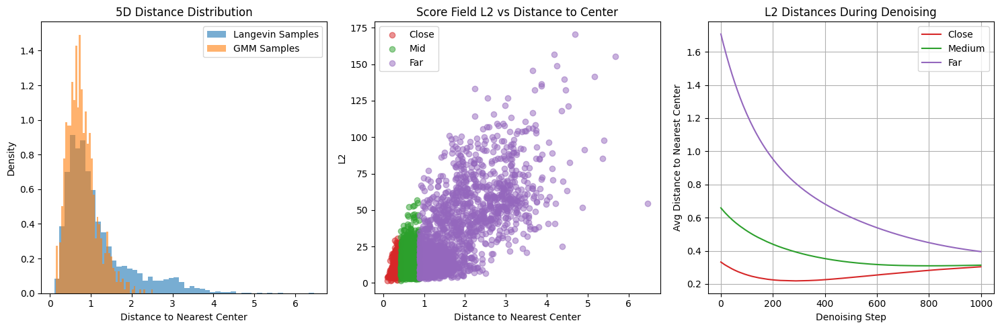

In [20]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['5d_diff']['mus']
covs = gmm_params['5d_diff']['covs']
weights = gmm_params['5d_diff']['weights']
dim = gmm_params['5d_diff']['n_features']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_noise_type = 'uniform'

model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/uniform/noise_scale_1_10PointUNet_denoising/gmm_new_5d/sharp/100000/denoiser_epoch_10.pt'


fig  = analyze_high_d(
    model_path=model_path,
    gmm_params=(mus, covs, weights, dim),
    device='cpu',
    model_noise_type=model_noise_type
)

<ipython-input-16-710692f76e5a>:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.4462
Iteration 100: sigma=0.1983
Iteration 200: sigma=0.0935
Iteration 300: sigma=0.0599
Iteration 400: sigma=0.0464
Iteration 500: sigma=0.0380
Iteration 600: sigma=0.0316
Iteration 700: sigma=0.0264
Iteration 800: sigma=0.0222
Iteration 900: sigma=0.0188
Iteration 1000: sigma=0.0160
Final sigma: 0.0160, total iterations: 1000
Avg time per iteration: 0.1754 s


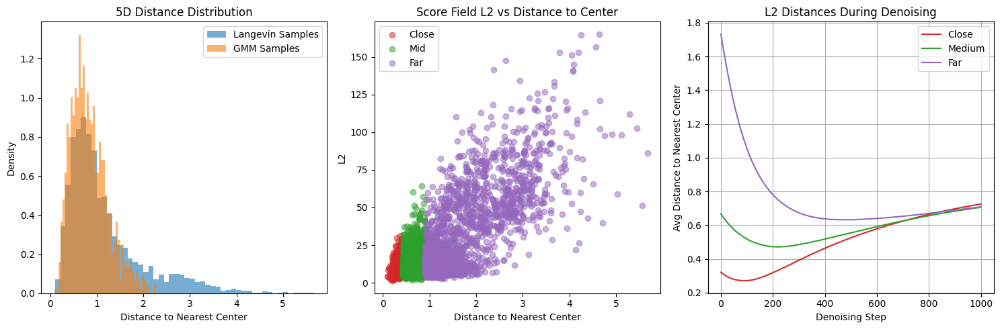

In [21]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['5d_diff']['mus']
covs = gmm_params['5d_diff']['covs']
weights = gmm_params['5d_diff']['weights']
dim = gmm_params['5d_diff']['n_features']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_noise_type = 'gaussian'

model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/gaussian/noise_scale_1_10PointUNet_denoising/gmm_new_5d/sharp/100000/denoiser_epoch_10.pt'


fig  = analyze_high_d(
    model_path=model_path,
    gmm_params=(mus, covs, weights, dim),
    device='cpu',
    model_noise_type=model_noise_type
)

<ipython-input-16-710692f76e5a>:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.5160
Iteration 100: sigma=0.2278
Iteration 200: sigma=0.0958
Iteration 300: sigma=0.0503
Iteration 400: sigma=0.0339
Iteration 500: sigma=0.0261
Iteration 600: sigma=0.0216
Iteration 700: sigma=0.0187
Iteration 800: sigma=0.0165
Iteration 900: sigma=0.0149
Iteration 1000: sigma=0.0135
Final sigma: 0.0135, total iterations: 1000
Avg time per iteration: 0.1760 s


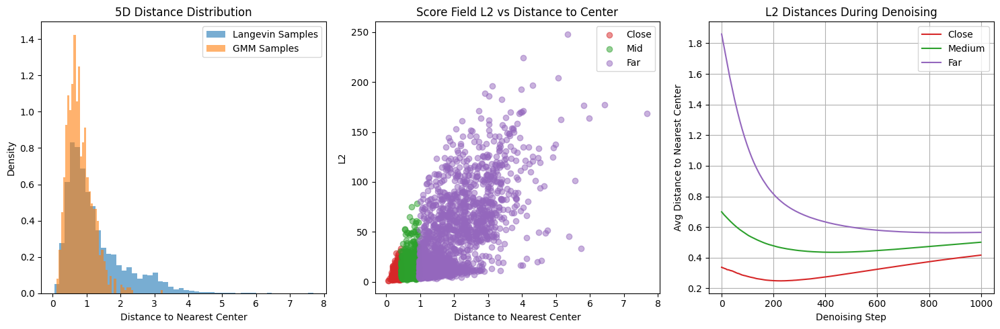

In [27]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['5d_diff']['mus']
covs = gmm_params['5d_diff']['covs']
weights = gmm_params['5d_diff']['weights']
dim = gmm_params['5d_diff']['n_features']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_noise_type = 'laplace'

model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/laplace/noise_scale_1_10PointUNet_denoising/gmm_new_5d/sharp/100000/denoiser_epoch_10.pt'


fig  = analyze_high_d(
    model_path=model_path,
    gmm_params=(mus, covs, weights, dim),
    device='cpu',
    model_noise_type=model_noise_type
)

<ipython-input-34-710692f76e5a>:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))
<ipython-input-4-5f69a38

Iteration 1: sigma=0.0684
Iteration 100: sigma=0.0469
Iteration 200: sigma=0.0377
Iteration 300: sigma=0.0327
Iteration 400: sigma=0.0293
Iteration 500: sigma=0.0266
Iteration 600: sigma=0.0241
Iteration 700: sigma=0.0220
Iteration 800: sigma=0.0202
Iteration 900: sigma=0.0185
Iteration 1000: sigma=0.0168
Final sigma: 0.0168, total iterations: 1000
Avg time per iteration: 0.0428 s


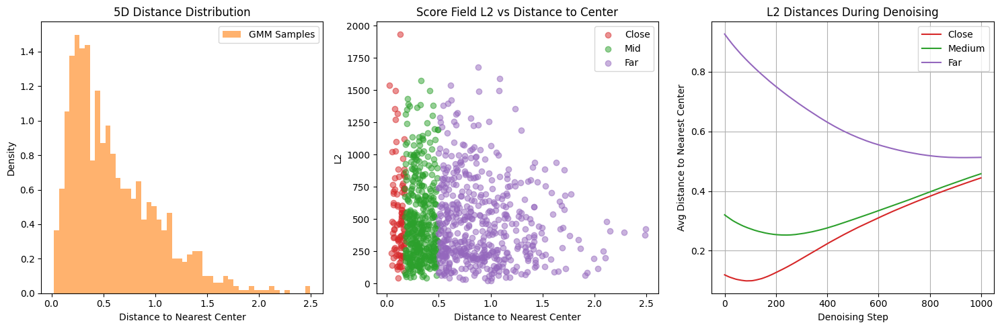

In [53]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['5d_sharp']['mus']
covs = gmm_params['5d_sharp']['covs']
weights = gmm_params['5d_sharp']['weights']
dim = gmm_params['5d_sharp']['n_features']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_noise_type = 'uniform'

model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/uniform/noise_scale_1_10PointUNet_denoising/gmm_new_5d/very_sharp/100000/denoiser_epoch_10.pt'


fig  = analyze_high_d(
    model_path=model_path,
    gmm_params=(mus, covs, weights, dim),
    device='cpu',
    model_noise_type=model_noise_type
)

<ipython-input-34-710692f76e5a>:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))
<ipython-input-4-5f69a38

Iteration 1: sigma=0.0837
Iteration 100: sigma=0.0424
Iteration 200: sigma=0.0258
Iteration 300: sigma=0.0189
Iteration 400: sigma=0.0156
Iteration 500: sigma=0.0136
Iteration 600: sigma=0.0121
Iteration 700: sigma=0.0109
Final sigma: 0.0100, total iterations: 790
Avg time per iteration: 0.0637 s


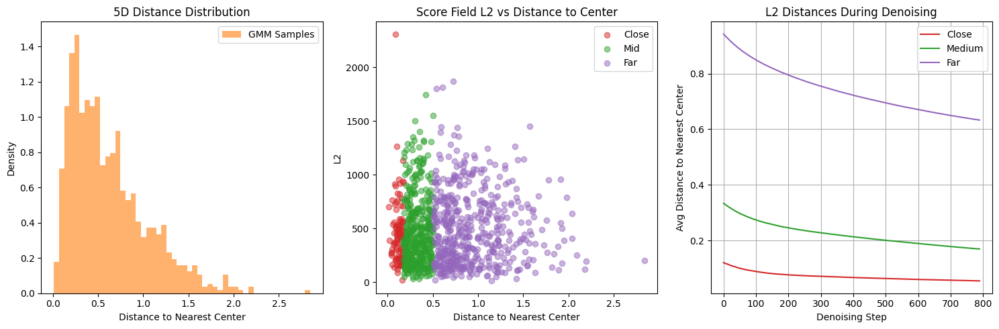

In [52]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['5d_sharp']['mus']
covs = gmm_params['5d_sharp']['covs']
weights = gmm_params['5d_sharp']['weights']
dim = gmm_params['5d_sharp']['n_features']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_noise_type = 'gaussian'

model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/gaussian/noise_scale_1_10PointUNet_denoising/gmm_new_5d/very_sharp/100000/denoiser_epoch_10.pt'


fig  = analyze_high_d(
    model_path=model_path,
    gmm_params=(mus, covs, weights, dim),
    device='cpu',
    model_noise_type=model_noise_type
)

<ipython-input-34-710692f76e5a>:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))
<ipython-input-4-5f69a38

Iteration 1: sigma=0.0788
Iteration 100: sigma=0.0362
Iteration 200: sigma=0.0207
Iteration 300: sigma=0.0156
Iteration 400: sigma=0.0137
Iteration 500: sigma=0.0127
Iteration 600: sigma=0.0120
Iteration 700: sigma=0.0115
Iteration 800: sigma=0.0110
Iteration 900: sigma=0.0106
Iteration 1000: sigma=0.0103
Final sigma: 0.0103, total iterations: 1000
Avg time per iteration: 0.0454 s


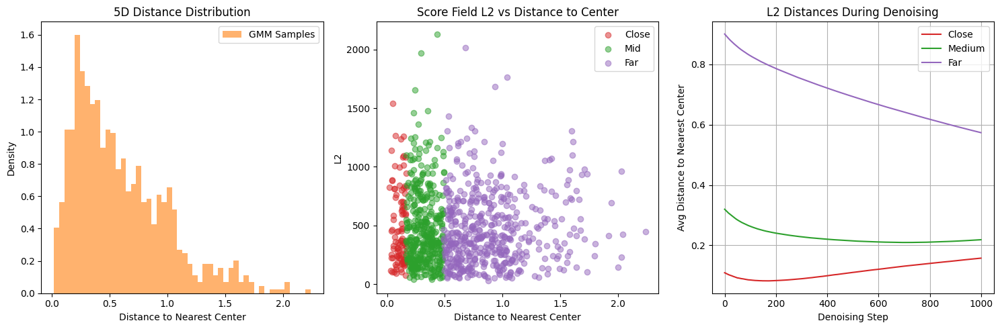

In [51]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['5d_sharp']['mus']
covs = gmm_params['5d_sharp']['covs']
weights = gmm_params['5d_sharp']['weights']
dim = gmm_params['5d_sharp']['n_features']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_noise_type = 'laplace'

model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/laplace/noise_scale_1_10PointUNet_denoising/gmm_new_5d/very_sharp/100000/denoiser_epoch_10.pt'


fig  = analyze_high_d(
    model_path=model_path,
    gmm_params=(mus, covs, weights, dim),
    device='cpu',
    model_noise_type=model_noise_type
)

In [31]:
def load_models(model_base_path, device):
   noise_types = ['gaussian', 'uniform', 'laplace']
   models = {}

   for noise_type in noise_types:
       model_path = f"{model_base_path}/{noise_type}/noise_scale_1_10PointUNet_denoising/gmm_new_5d/100000/denoiser_epoch_10.pt"

       #load model
       class Args:
           def __init__(self):
               self.num_blocks = 3
               self.num_kernels = 64
               self.num_enc_conv = 2
               self.num_mid_conv = 2
               self.num_dec_conv = 2
               self.bias = True
               self.input_dim = 5

       args = Args()
       model = PointUNet(args).to(device)
       model.load_state_dict(torch.load(model_path, map_location=device))
       model = model.to(device)
       model.eval()

       models[noise_type] = model

   return models

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
base_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests'
models = load_models(base_path, device)

def analyze_convergence(models, test_points, device, gmm_params):
    convergence_curves = {noise_type: [] for noise_type in models.keys()}
    mus = [torch.tensor(mu, device=device) for mu in gmm_params['5d_sharp']['mus']]

    for noise_type, model in models.items():
        _, trajectories, _ = univ_inv_solve_gmm(model, test_points, device, noise_type=noise_type)

        #track convergence to centers
        for t in range(len(trajectories)):
            dists = torch.stack([torch.norm(trajectories[t] - mu, dim=1) for mu in mus])
            min_dists = torch.min(dists, dim=0)[0].mean()
            convergence_curves[noise_type].append(min_dists.item())

    plt.figure(figsize=(10, 6))
    for noise_type, curve in convergence_curves.items():
        plt.plot(curve, label=noise_type)
    plt.xlabel('Steps')
    plt.ylabel('Average Distance to Nearest Center')
    plt.title('Convergence Curves by Noise Type')
    plt.legend()
    plt.yscale('log')
    plt.show()

<ipython-input-31-a3314ca9f8aa>:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


<ipython-input-34-710692f76e5a>:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.5542
Iteration 100: sigma=0.2174
Iteration 200: sigma=0.1012
Iteration 300: sigma=0.0660
Iteration 400: sigma=0.0534
Iteration 500: sigma=0.0459
Iteration 600: sigma=0.0397
Iteration 700: sigma=0.0344
Iteration 800: sigma=0.0298
Iteration 900: sigma=0.0258
Iteration 1000: sigma=0.0223
Final sigma: 0.0223, total iterations: 1000
Avg time per iteration: 0.0407 s


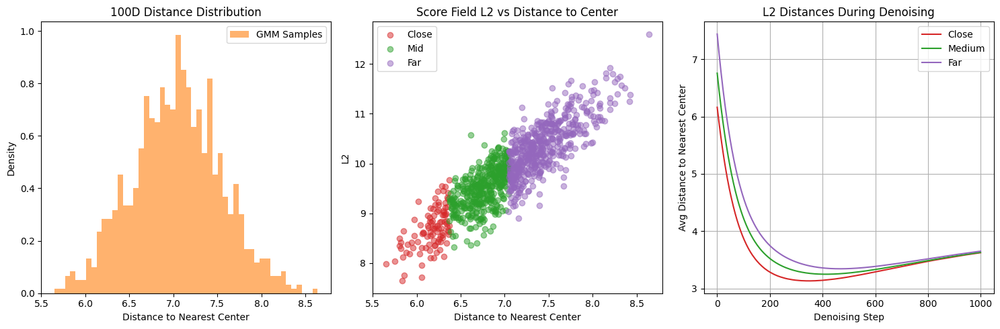

In [48]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['100d']['mus']
covs = gmm_params['100d']['covs']
weights = gmm_params['100d']['weights']
dim = gmm_params['100d']['n_features']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_noise_type = 'uniform'

model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/uniform/noise_scale_1_10PointUNet_denoising/gmm_new_100d/100000/denoiser_epoch_10.pt'


fig  = analyze_high_d(
    model_path=model_path,
    gmm_params=(mus, covs, weights, dim),
    device='cpu',
    model_noise_type=model_noise_type
)

<ipython-input-34-710692f76e5a>:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.5692
Iteration 100: sigma=0.2303
Iteration 200: sigma=0.1141
Iteration 300: sigma=0.0772
Iteration 400: sigma=0.0604
Iteration 500: sigma=0.0486
Iteration 600: sigma=0.0402
Iteration 700: sigma=0.0339
Iteration 800: sigma=0.0288
Iteration 900: sigma=0.0245
Iteration 1000: sigma=0.0207
Final sigma: 0.0207, total iterations: 1000
Avg time per iteration: 0.0408 s


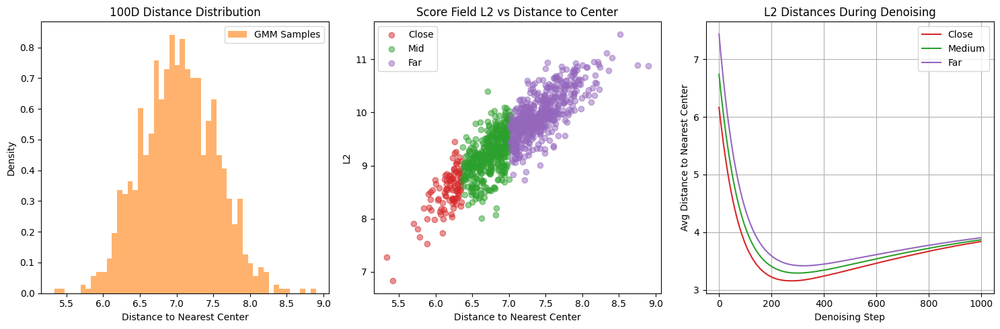

In [49]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['100d']['mus']
covs = gmm_params['100d']['covs']
weights = gmm_params['100d']['weights']
dim = gmm_params['100d']['n_features']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_noise_type = 'laplace'

model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/laplace/noise_scale_1_10PointUNet_denoising/gmm_new_100d/100000/denoiser_epoch_10.pt'


fig  = analyze_high_d(
    model_path=model_path,
    gmm_params=(mus, covs, weights, dim),
    device='cpu',
    model_noise_type=model_noise_type
)

<ipython-input-34-710692f76e5a>:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Iteration 1: sigma=0.5774
Iteration 100: sigma=0.2254
Iteration 200: sigma=0.1016
Iteration 300: sigma=0.0626
Iteration 400: sigma=0.0488
Iteration 500: sigma=0.0410
Iteration 600: sigma=0.0350
Iteration 700: sigma=0.0300
Iteration 800: sigma=0.0257
Iteration 900: sigma=0.0221
Iteration 1000: sigma=0.0190
Final sigma: 0.0190, total iterations: 1000
Avg time per iteration: 0.0409 s


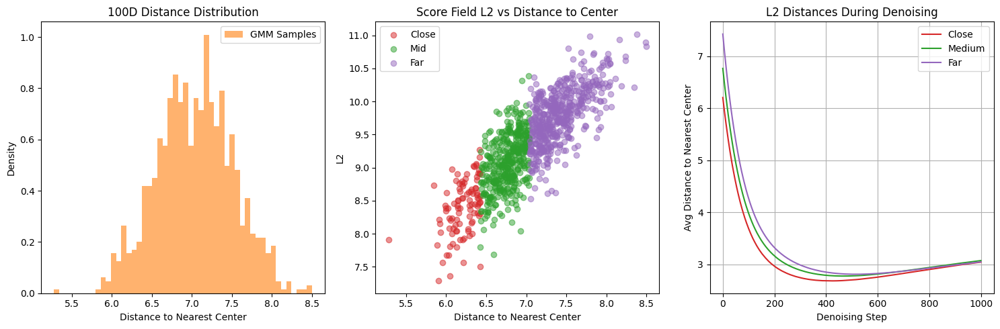

In [50]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['100d']['mus']
covs = gmm_params['100d']['covs']
weights = gmm_params['100d']['weights']
dim = gmm_params['100d']['n_features']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_noise_type = 'gaussian'

model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/gaussian/noise_scale_1_10PointUNet_denoising/gmm_new_100d/100000/denoiser_epoch_10.pt'


fig  = analyze_high_d(
    model_path=model_path,
    gmm_params=(mus, covs, weights, dim),
    device='cpu',
    model_noise_type=model_noise_type
)

<ipython-input-34-710692f76e5a>:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))
<ipython-input-4-5f69a38

Iteration 1: sigma=0.0277
Iteration 100: sigma=0.0210
Iteration 200: sigma=0.0186
Iteration 300: sigma=0.0170
Iteration 400: sigma=0.0156
Iteration 500: sigma=0.0143
Iteration 600: sigma=0.0133
Iteration 700: sigma=0.0125
Iteration 800: sigma=0.0117
Iteration 900: sigma=0.0111
Iteration 1000: sigma=0.0105
Final sigma: 0.0105, total iterations: 1000
Avg time per iteration: 0.0407 s


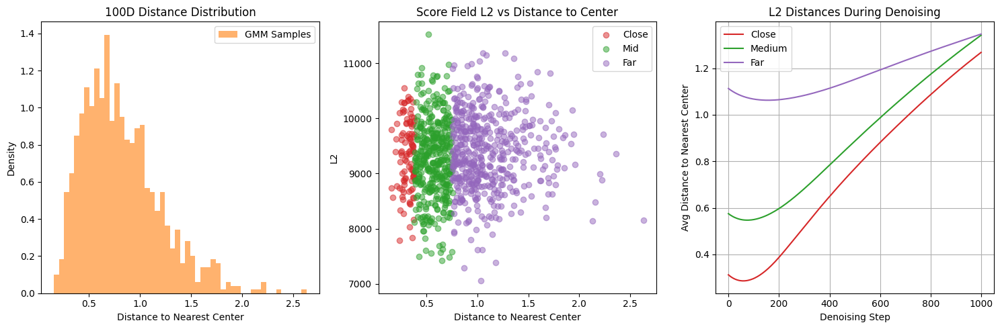

In [54]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['100d_diff']['mus']
covs = gmm_params['100d_diff']['covs']
weights = gmm_params['100d_diff']['weights']
dim = gmm_params['100d_diff']['n_features']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_noise_type = 'uniform'

model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/uniform/noise_scale_1_10PointUNet_denoising/gmm_new_100d/sharp/100000/denoiser_epoch_10.pt'


fig  = analyze_high_d(
    model_path=model_path,
    gmm_params=(mus, covs, weights, dim),
    device='cpu',
    model_noise_type=model_noise_type
)

<ipython-input-34-710692f76e5a>:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))
<ipython-input-4-5f69a38

Iteration 1: sigma=0.0361
Iteration 100: sigma=0.0195
Iteration 200: sigma=0.0135
Iteration 300: sigma=0.0110
Iteration 400: sigma=0.0096
Iteration 500: sigma=0.0087
Iteration 600: sigma=0.0079
Iteration 700: sigma=0.0073
Iteration 800: sigma=0.0068
Iteration 900: sigma=0.0064
Iteration 1000: sigma=0.0059
Final sigma: 0.0059, total iterations: 1000
Avg time per iteration: 0.0419 s


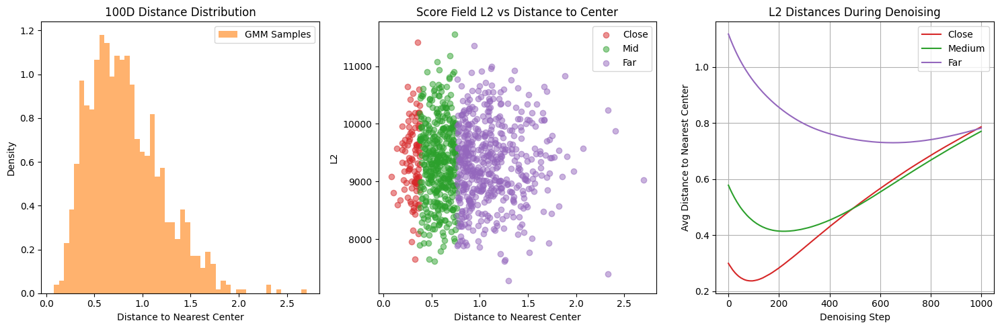

In [65]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['100d_diff']['mus']
covs = gmm_params['100d_diff']['covs']
weights = gmm_params['100d_diff']['weights']
dim = gmm_params['100d_diff']['n_features']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_noise_type = 'laplace'

model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/laplace/noise_scale_1_10PointUNet_denoising/gmm_new_100d/sharp/100000/denoiser_epoch_10.pt'


fig  = analyze_high_d(
    model_path=model_path,
    gmm_params=(mus, covs, weights, dim),
    device='cpu',
    model_noise_type=model_noise_type
)

<ipython-input-34-710692f76e5a>:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))
<ipython-input-4-5f69a38

Iteration 1: sigma=0.0295
Iteration 100: sigma=0.0157
Iteration 200: sigma=0.0105
Iteration 300: sigma=0.0080
Iteration 400: sigma=0.0064
Iteration 500: sigma=0.0054
Final sigma: 0.0050, total iterations: 541
Avg time per iteration: 0.0425 s


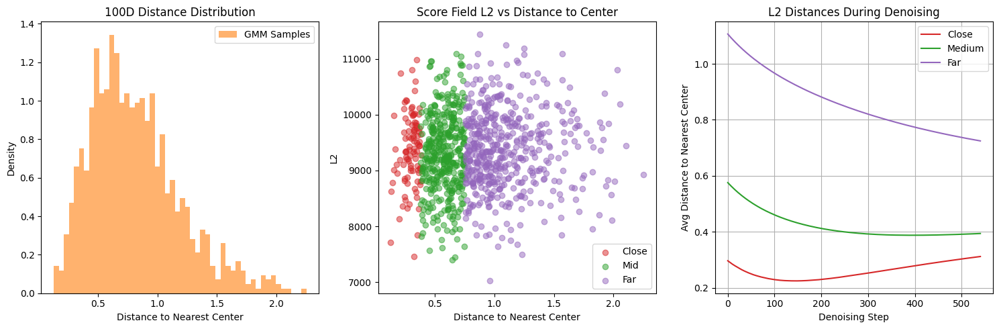

In [64]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['100d_diff']['mus']
covs = gmm_params['100d_diff']['covs']
weights = gmm_params['100d_diff']['weights']
dim = gmm_params['100d_diff']['n_features']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_noise_type = 'gaussian'

model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/gaussian/noise_scale_1_10PointUNet_denoising/gmm_new_100d/sharp/100000/denoiser_epoch_10.pt'


fig  = analyze_high_d(
    model_path=model_path,
    gmm_params=(mus, covs, weights, dim),
    device='cpu',
    model_noise_type=model_noise_type
)

<ipython-input-34-710692f76e5a>:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))
<ipython-input-4-5f69a38

Iteration 1: sigma=0.0201
Iteration 100: sigma=0.0140
Iteration 200: sigma=0.0117
Iteration 300: sigma=0.0104
Iteration 400: sigma=0.0095
Iteration 500: sigma=0.0087
Iteration 600: sigma=0.0080
Iteration 700: sigma=0.0075
Iteration 800: sigma=0.0070
Iteration 900: sigma=0.0065
Iteration 1000: sigma=0.0061
Final sigma: 0.0061, total iterations: 1000
Avg time per iteration: 0.0410 s


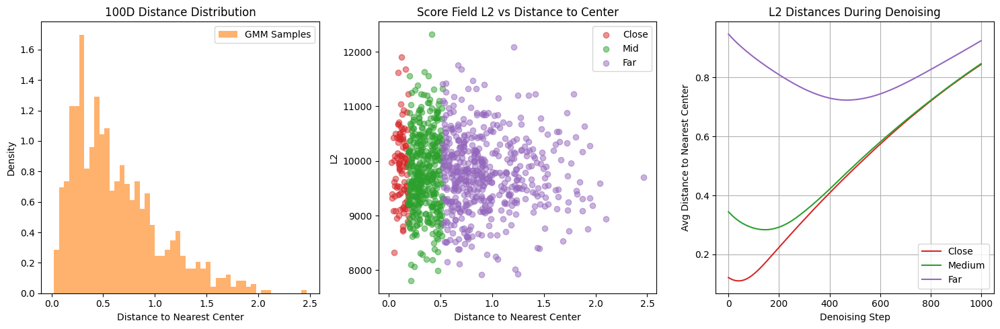

In [63]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['100d_sharp']['mus']
covs = gmm_params['100d_sharp']['covs']
weights = gmm_params['100d_sharp']['weights']
dim = gmm_params['100d_sharp']['n_features']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_noise_type = 'uniform'

model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/uniform/noise_scale_1_10PointUNet_denoising/gmm_new_100d/very_sharp/100000/denoiser_epoch_10.pt'


fig  = analyze_high_d(
    model_path=model_path,
    gmm_params=(mus, covs, weights, dim),
    device='cpu',
    model_noise_type=model_noise_type
)

<ipython-input-34-710692f76e5a>:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))
<ipython-input-4-5f69a38

Iteration 1: sigma=0.0349
Iteration 100: sigma=0.0198
Iteration 200: sigma=0.0127
Iteration 300: sigma=0.0087
Iteration 400: sigma=0.0061
Final sigma: 0.0050, total iterations: 462
Avg time per iteration: 0.0417 s


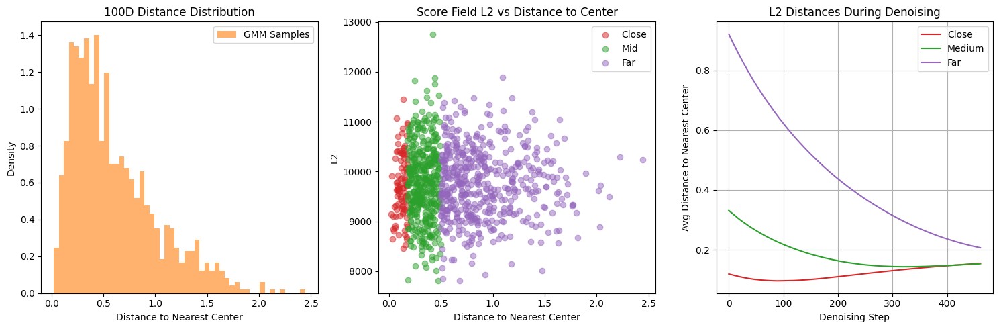

In [62]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['100d_sharp']['mus']
covs = gmm_params['100d_sharp']['covs']
weights = gmm_params['100d_sharp']['weights']
dim = gmm_params['100d_sharp']['n_features']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_noise_type = 'laplace'

model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/laplace/noise_scale_1_10PointUNet_denoising/gmm_new_100d/very_sharp/100000/denoiser_epoch_10.pt'


fig  = analyze_high_d(
    model_path=model_path,
    gmm_params=(mus, covs, weights, dim),
    device='cpu',
    model_noise_type=model_noise_type
)

<ipython-input-34-710692f76e5a>:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))
<ipython-input-4-5f69a38

Iteration 1: sigma=0.0233
Iteration 100: sigma=0.0137
Iteration 200: sigma=0.0102
Iteration 300: sigma=0.0083
Iteration 400: sigma=0.0068
Iteration 500: sigma=0.0057
Final sigma: 0.0050, total iterations: 580
Avg time per iteration: 0.0421 s


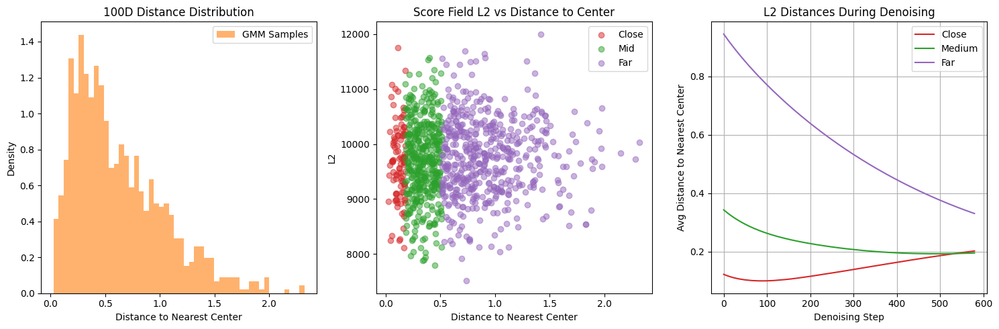

In [61]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
mus = gmm_params['100d_sharp']['mus']
covs = gmm_params['100d_sharp']['covs']
weights = gmm_params['100d_sharp']['weights']
dim = gmm_params['100d_sharp']['n_features']

mus = [np.array(mu) for mu in mus]
covs = [np.array(cov) for cov in covs]
weights = np.array(weights)
model_noise_type = 'gaussian'

model_path = '/content/drive/MyDrive/UT_Austin/Diffusion_Models_Testing/memorization_generalization_in_diffusion_models/denoisers/noise_tests/gaussian/noise_scale_1_10PointUNet_denoising/gmm_new_100d/very_sharp/100000/denoiser_epoch_10.pt'


fig  = analyze_high_d(
    model_path=model_path,
    gmm_params=(mus, covs, weights, dim),
    device='cpu',
    model_noise_type=model_noise_type
)